# Data Integration and Reshaping
#### Author: Dhrruv Tokas
#### Email ID:dhrruvtokas@gmail.com

Date: 12/10/2020

Environment: Python 3.6.0 and Anaconda 4.3.0 (64-bit)

Main Libraries used:
* regex 2020.7.14 (mainly for regular expression, included in Anaconda Python 3.6) 
* pandas 1.0.1 (mainly for csv operations, included in Anaconda Python 3.6) 
* nltk 3.4.5 (mainly for Analysis, included in Anaconda Python 3.6) 
* numpy 1.18.1 (mainly for arrays and math operations, included in Anaconda Python 3.6) 
* matplotlib 3.3.2 (mainly for plotting visualizations, included in Anaconda Python 3.6) 
* sklearn 0.22.1 (mainly for linear regression, included in Anaconda Python 3.6) 
* xmltodict 0.12.0 (mainly used for XML related operations, included in Anaconda Python 3.6)
* tabula-py 1.4.1 (mainly used for PDF related operations, included in Anaconda Python 3.6)
* geopandas 0.8.1 (mainly used for shape files, included in Anaconda Python 3.6)
* beautifulsoup4 4.9.3 (mainly used for , included in Anaconda Python 3.6)
* html5lib 1.1 (mainly used for HTML related operations, included in Anaconda Python 3.6)

Platform Used:
* Microsoft Windows 10

# Task1: DATA INTEGRATION

# 1. Introduction

This analysis focuses on `Data Integration` and `Data Reshaping`, and for the same purpose I was provided 7 different datasets includin  hospitals,
supermarkets, shopping centers, real estate which needs to be grouped together in a single dataset. The dataset (all together) have a total of `21 different attributes` containing several tuples which will be displayed later for the same.

* Tasks that were performed:
1. Data Integration: The provided seven datasets were combined into a single dataset [`Section 7`]
2. Data Data Reshaping: Several transformation/normalisation methods (`Root Tranformation`, `Power Tranformation`, `Log Transfomation`, `Z-Score Tranformation`, and `MinMax Tranformation`) were briefly studied and explained [`Section 8`]. Then the resulting values were then used to `predict` the `property price` of each property by using a `Linear Model`.

* Conclusion:
All the process that have been done in order to get the the final ouput file (`dhrruvtokas_solution.csv`). The `property price` of each property was succesfully `predicted` in the later sections.

* References: Sources which have been used as a reference to complete this assignmnet

Other details are thoroughly provided in the following sections of the environment.

# 2. Importing Libraries
In this specific section, all the required `libraries` will be imported so these `packages` can be used later for the `Data Integration` and `Data Reshaping`. These libraries were used throughout the following sub-sections, each of these libraries serves their own `distinct` purpose.

In [1]:
import pandas as pd # Will be used for dataframes
from zipfile import ZipFile # Will be used for extracting datasets
import glob # Will be used to retrieve matchine filenames
import shutil # Will be used for file operations
import os # Will be used to change and traverse through directories
import re # Will be used for regular expression operations
import json # Will be used to read json files
import xmltodict # Will be used for converting xml into dictionary
import xml.etree.ElementTree as ET # Will be used for converting xml into dataframe
import tabula # Will be used for coverting pdf into a dataframe
from bs4 import BeautifulSoup as bs # Will be used for extracting xml tags
from itertools import zip_longest # Will be used to to iterate
import pysal as ps # Will be used to read the dbf file
import shapefile # Will  be used to read shp file
import geopandas as gpd # Will be used to read shp file
from shapely.geometry import MultiPolygon # Will be used to plot polygon coordinates
import matplotlib.pyplot as plt # Will be used to plot
import numpy as np # Will be used for shapefile
import math # Will be used for calculating haversine distance
from math import sin, cos, sqrt, atan2, radians, ceil # Will be used for calculate distance between two coordinates
from shapely.geometry import MultiPoint, Point, Polygon # Will be used for shapefile
from sklearn import preprocessing # Will be used for transformation
from sklearn.linear_model import LinearRegression # Will be used to create a linear model for predictions
from sklearn.model_selection import train_test_split # Will be used to train the data after applying transformation techniques
from scipy import stats # Will be used for transformation
import seaborn as sns # Will be used to plot distplot
# import pycrs


C:\Users\Dhrruv\anaconda3\envs\geo_env\lib\site-packages\pysal\explore\segregation\network\network.py:15: UserWarning: You need pandana and urbanaccess to work with segregation's network module
You can install them with  `pip install urbanaccess pandana` or `conda install -c udst pandana urbanaccess`
  warn(
C:\Users\Dhrruv\anaconda3\envs\geo_env\lib\site-packages\pysal\model\spvcm\abstracts.py:10: UserWarning: The `dill` module is required to use the sqlite backend fully.
  from .sqlite import head_to_sql, start_sql


# 3. Extracting The Required Datasets

## 3.1 Extracting The Student Dataset
The dataset named `dhrruvtokas.zip`was extracted and all of its sub-datasets was used as a part for the final dataset. A `ZipFile()` function was used to read the `dhrruvtokas.zip` dataset and a `extractall()` function was used to extract all those files which were present in this dataset. After the available files were extracted, the same dataset was later closed using a `close()` function.

In [2]:
student_data_name = "dhrruvtokas.zip" # Will store the name of the dataset
with ZipFile(student_data_name, 'r') as zip: # Will open the zip file to read
    print("Extracted Sub-datasets:\n") # Will display a label for the output
    zip.printdir() # Will display the sub-datasets which were extracted
    zip.extractall() # Will extract the sub-datasets
    zip.close() # Will close the file

Extracted Sub-datasets:

File Name                                             Modified             Size
hospitals.xlsx                                 2020-10-11 14:47:08        15500
real_state.json                                2020-10-11 14:47:08       188960
real_state.xml                                 2020-10-11 14:47:08       347636
shopingcenters.pdf                             2020-10-11 14:47:08        51370
supermarkets.html                              2020-10-11 14:47:08        32258


## 3.2 Extracting The GTFS Melbourne Train Information Dataset
The dataset named `GTFS_Melbourne_Train_Information.zip` was extracted and all of its sub-datasets was used as a part for the final dataset. A `ZipFile()` function was used to read the `GTFS_Melbourne_Train_Information.zip` dataset and a `extract()` function was used to extract all those files which were present in this dataset. After the available files were extracted, the same dataset was later closed using a `close()` function.

In [3]:
current_directory = os.getcwd() # Will retrieve and store the current working directory
gtfs_data_name = "GTFS_Melbourne_Train_Information.zip" # Will store the name of the dataset
print("Extracted Sub-datasets:\n") # Will display a label for the output
with ZipFile(gtfs_data_name) as zip: # Will open the zip file to read
    for zip_info in zip.infolist(): # Will return the zip_info objects
        if zip_info.filename[-1] == '/': # Will be used to recursively extract the sub-datasets
            continue
        zip_info.filename = os.path.basename(zip_info.filename) # Will extract the name of the sub-datasets
        zip.extract(zip_info, current_directory) # Will extract the sub-datasets into the main working directory
        print(zip.extract(zip_info, current_directory)) # Will display the name of each sub-dataset which was extracted
    zip.close() # Will close the file

Extracted Sub-datasets:

C:\Users\Dhrruv\Reshape\agency.txt
C:\Users\Dhrruv\Reshape\calendar.txt
C:\Users\Dhrruv\Reshape\calendar_dates.txt
C:\Users\Dhrruv\Reshape\routes.txt
C:\Users\Dhrruv\Reshape\shapes.txt
C:\Users\Dhrruv\Reshape\stops.txt
C:\Users\Dhrruv\Reshape\stop_times.txt
C:\Users\Dhrruv\Reshape\trips.txt


## 3.3 Extracting The Victoria Suburb Boundary Dataset
The dataset named `vic_suburb_boundary.zip` was extracted and all of its sub-datasets was used as a part for the final dataset. A `ZipFile()` function was used to read the `vic_suburb_boundary.zip` dataset and a `extractall()` function was used to extract all those files which were present in this dataset. After the available files were extracted, the same dataset was later closed using a `close()` function.

In [4]:
suburb_data_name = "vic_suburb_boundary.zip" # Will store the name of the dataset
with ZipFile(suburb_data_name, 'r') as zip: # Will open the zip file to read
    print("Extracted Sub-datasets:\n") # Will display a label for the output
    zip.printdir() # Will display the sub-datasets which were extracted
    zip.extractall() # Will extract the sub-datasets
    zip.close() # Will close the file

Extracted Sub-datasets:

File Name                                             Modified             Size
VIC_LOCALITY_POLYGON_shp.dbf                   2017-08-23 16:04:50       580152
VIC_LOCALITY_POLYGON_shp.prj                   2017-08-23 16:04:50          136
VIC_LOCALITY_POLYGON_shp.shp                   2017-08-23 16:04:54     32905556
VIC_LOCALITY_POLYGON_shp.shx                   2017-08-23 16:04:54        23884


# 4. Loading the Student Dataset 
The sub-datasets of the dataset named `dhrruvtokas.zip` which was extracted in the `section 3.1` were read and displayed in the following sub-sections and these sub-datasets were `hospitals.xlsx`, `real_state.json`, `real_state.xlsx` ,`shoppingcenter.pdf`, and `supermarkets.html` respectively.

## 4.1 Displaying Hospitals Sub-dataset
The following section examined and displayed the `hospitals.xlsx` sub-dataset by using a `read_excel()` function of the `pandas` package. In addition to this, an unnecessary column named `Unnamed: 0` (`index column`) were then `dropped` to preserve the original sub-dataset, and then the sub-dataset stored in a dataframe was displayed.

In [5]:
pd.set_option('display.max_rows', None) # Will set the maximum rows to none 
hospital_read_data = pd.read_excel('hospitals.xlsx') # Will read the excel file
hospital_read_data = hospital_read_data.drop(['Unnamed: 0'],axis=1) # Will remove the unwanted index column
hospital_read_data # Will display the excel file

,id,lat,lng,name
0,hospital_001,-37.990622,145.072836,Como Private Hospital
1,hospital_002,-37.855469,145.268183,Mountain District Private Hospital
2,hospital_003,-37.792230,144.889128,Western Hospital
3,hospital_004,-37.756042,145.061896,Mercy Hospital for Women
4,hospital_005,-37.760623,144.815624,Sunshine Hospital
5,hospital_006,-36.359274,145.410832,Shepparton Private Hospital
6,hospital_007,-37.774573,144.923973,Ascot Vale Road Specialist Rooms
7,hospital_008,-37.849467,145.226801,Knox Private Hospital
8,hospital_009,-37.869801,145.003096,Masada Private Hospital
9,hospital_010,-37.810454,145.194100,Mitcham Private Hospital


## 4.2 Displaying The Real State Sub-dataset - JSON
The following section examined and displayed the `real_state.json` sub-dataset by using a `read_json()` function, and then the sub-dataset stored in a dataframe was displayed.

In [6]:
real_state_json_data = pd.read_json(r'real_state.json') # Will load the matching (real state json dataset
real_state_json_data # Will display the dataset

,property_id,lat,lng,addr_street,price,property_type,year,bedrooms,bathrooms,parking_space
0,50303,-37.775729,145.097898,56 Millicent Avenue,9500000,house,2015,3,1,2
1,34690,-37.708595,145.009893,32 Macartney Street,4576000,house,2010,4,2,1
2,31220,-37.753215,144.990390,39 Rennie Street,16371000,house,2009,4,2,2
3,91147,-37.984524,145.049367,10 Valmont Avenue,11400000,house,2013,4,2,2
4,33829,-37.719739,145.026191,14 Keilor Avenue,3942000,house,2011,3,1,2
5,93141,-37.995997,145.085768,3 Carrier Avenue,7900000,house,2010,4,2,3
6,16000,-37.704746,144.878601,2/6 Spring Street,4004000,house,2008,3,2,1
7,25837,-37.580432,144.927334,2 Perth Street,6120000,house,2016,3,2,1
8,53073,-37.824390,145.007202,332 Burnley Street,5664000,house,2009,2,1,0
9,20042,-37.793156,144.969437,1306/570 Lygon Street,2120000,house,2009,1,1,1


## 4.3 Displaying The Real State Sub-dataset - XML
The following section examined (by using a `open()` function) and displayed (by using a `read()` function) the `real_state.xml` sub-dataset. After the sub-dataset was read and displayed, the `XML` was then closed using a `close()` function. 

In [7]:
real_state_xml_open = open("real_state.xml", "r") # Will open the real state xml file to read
real_state_xml_read = real_state_xml_open.read() # Will read the xml file
real_state_xml_open.close() # XML file will be closed
real_state_xml_read # Will display the contents of the xml file

'b\'<?xml version="1.0" encoding="UTF-8" ?><root><property_id type="dict"><n68590 type="int">69125</n68590><n11480 type="int">11995</n11480><n39626 type="int">40161</n39626><n25548 type="int">26083</n25548><n94054 type="int">94589</n94054><n47785 type="int">48320</n47785><n24074 type="int">24609</n24074><n1004 type="int">1009</n1004><n64736 type="int">65271</n64736><n81832 type="int">82367</n81832><n87652 type="int">88187</n87652><n11872 type="int">12387</n11872><n51790 type="int">52325</n51790><n44057 type="int">44592</n44057><n60980 type="int">61515</n60980><n69098 type="int">69633</n69098><n94160 type="int">94695</n94160><n54040 type="int">54575</n54040><n8227 type="int">8248</n8227><n79945 type="int">80480</n79945><n56526 type="int">57061</n56526><n93358 type="int">93893</n93358><n57055 type="int">57590</n57055><n12005 type="int">12520</n12005><n91266 type="int">91801</n91266><n45020 type="int">45555</n45020><n90068 type="int">90603</n90068><n88183 type="int">88718</n88183><n66770 

### 4.3.1 Cleaning The Real State XML File
The `real state xml` dataset which was extracted in the section above contained some `invalid charaters` such as `b and '` at the beginning of the file as well as at the end of the file. These errors were removed using the `slicing method` so the extracted dataset can be parsed into a dataframe. After those `invalid characters` were sliced, the original dataset (stored inside a dataframe named `real_state_xml_data`) was displayed.

In [8]:
real_state_xml_read = "".join(real_state_xml_read) # Will covert the xml into string
real_state_xml_data = real_state_xml_read[2:-1] # Will remove the invalid xml characters
real_state_xml_data # Will display the valid xml data

'<?xml version="1.0" encoding="UTF-8" ?><root><property_id type="dict"><n68590 type="int">69125</n68590><n11480 type="int">11995</n11480><n39626 type="int">40161</n39626><n25548 type="int">26083</n25548><n94054 type="int">94589</n94054><n47785 type="int">48320</n47785><n24074 type="int">24609</n24074><n1004 type="int">1009</n1004><n64736 type="int">65271</n64736><n81832 type="int">82367</n81832><n87652 type="int">88187</n87652><n11872 type="int">12387</n11872><n51790 type="int">52325</n51790><n44057 type="int">44592</n44057><n60980 type="int">61515</n60980><n69098 type="int">69633</n69098><n94160 type="int">94695</n94160><n54040 type="int">54575</n54040><n8227 type="int">8248</n8227><n79945 type="int">80480</n79945><n56526 type="int">57061</n56526><n93358 type="int">93893</n93358><n57055 type="int">57590</n57055><n12005 type="int">12520</n12005><n91266 type="int">91801</n91266><n45020 type="int">45555</n45020><n90068 type="int">90603</n90068><n88183 type="int">88718</n88183><n66770 typ

### 4.3.2 Finding The Names Of The Available Columns In The Real State Dataset - XML
A list of available columns in the `real state dataset` were extracted in the following section, this operation was carried by using the `BeautifulSoup` pacakge. Then a `find()` function was used to find the `root node` of the `XML` file, a list named `real_state_attributes` was also used to store the name of its columns, and at the end, the total number of columns was then displayed.

In [9]:
soup = bs(real_state_xml_data, "lxml") # Will load the xml dataset in the soup function
tag_name = soup.find('root') # Will find the root node
children = tag_name.children # Will be used to find the children
print("Available Attributes:\n") # Will display a label for the output
count = 0 # Will keep a count on the number of attributes
real_state_attributes = [] # Will create an empty list to store the column names
while True: # While children (tag name) exists
    try: # For each existing tag name
        print(next(children).name) # Will display the attributes
        count = count + 1 # Will increment the count by 1
    except: # If there is no attribute left
        break # Exit
print("\nTotal Attributes: ", count) # Will display the number of attributes

Available Attributes:

property_id
lat
lng
addr_street
price
property_type
year
bedrooms
bathrooms
parking_space

Total Attributes:  10


### 4.3.3 Converting The Real State Sub-dataset Into A Dataframe - XML
The Real State XML Sub-dataset which was extracted in the section above will be converted into a dataframe in the following section. The attribute names which were found out in the previous section will be used (by uisng the `findAll()` function) in this section and the data that they carry will be extracted using a combinaton of `BeautifulSoup` package and `re` package. The `Regular Expression` `r"n:?\d{1,6}"` used in the following section work as follows:
* n:? = Will check if the matching pattern starts with the n letter
* \d{1,6} =  Will check if the matching pattern is a number of maximum 6 digits
The extracted dataset was then stored into a dataframe named `real_state_xml_data_final` which was displayed at the end of this section.

In [10]:
soup = bs(real_state_xml_data, "lxml") # Will load the xml dataset in the soup function
property_id = soup.findAll('property_id') # Will find the property_id tag
latitude = soup.findAll('lat') # Will find the lat tag
longitude = soup.findAll('lng') # Will find the lng tag
address_street = soup.findAll('addr_street') # Will find the addr_street tag
price = soup.findAll('price') # Will find the price tag
property_type = soup.findAll('property_type') # Will find the property_type tag 
year = soup.findAll('year') # Will find the year tag
bedrooms = soup.findAll('bedrooms') # Will find the bedrooms tag
bathrooms = soup.findAll('bathrooms') # Will find the bathrooms tag
parking_space = soup.findAll('parking_space') # Will find the parking_space tag

property_list = [] # Will create an empty list which will be used to store the property ids
latitude_list = [] # Will create an empty list which will be used to store the latitude values
longitude_list = [] # Will create an empty list which will be used to store the longitude values
address_street_list = [] # Will create an empty list which will be used to store the addresses
price_list = [] # Will create an empty list which will be used to store the prices
property_type_list = [] # Will create an empty list which will be used to store the property types
year_list = [] # Will create an empty list which will be used to store the years
bedrooms_list = [] # Will create an empty list which will be used to store the number of bedrooms
bathrooms_list = [] # Will create an empty list which will be used to store the number of bathrooms
parking_space_list = [] # Will create an empty list which will be used to store the number of parking spaces

pattern = r"n:?\d{1,6}" # A pattern which will be matched to extract the required data

for prop, lat, long, addr_st, price_amt, prop_typ, year_no, bed_no, bath_no, park_sp  in zip_longest(property_id, latitude, longitude, address_street, price, property_type, year, bedrooms, bathrooms, parking_space): # For each value of all the attributes in the dataset
    property_list.append([row.text for row in prop.findAll(re.compile(pattern))]) # Will find the matching pattern and will store the property id in the list
    latitude_list.extend([row.text for row in lat.findAll(re.compile(pattern))]) # Will find the matching pattern and will store the latitude value in the list
    longitude_list.extend([row.text for row in long.findAll(re.compile(pattern))]) # Will find the matching pattern and will store the longitude value in the list
    address_street_list.extend([row.text for row in addr_st.findAll(re.compile(pattern))]) # Will find the matching pattern and will store the addresses in the list
    price_list.extend([row.text for row in price_amt.findAll(re.compile(pattern))]) # Will find the matching pattern and will store the prices in the list
    property_type_list.extend([row.text for row in prop_typ.findAll(re.compile(pattern))]) # Will find the matching pattern and will store the property types in the list
    year_list.extend([row.text for row in year_no.findAll(re.compile(pattern))]) # Will find the matching pattern and will store the year in the list
    bedrooms_list.extend([row.text for row in bed_no.findAll(re.compile(pattern))]) # Will find the matching pattern and will store the property id in the list
    bathrooms_list.extend([row.text for row in bath_no.findAll(re.compile(pattern))]) # Will find the matching pattern and will store the property id in the list
    parking_space_list.extend([row.text for row in park_sp.findAll(re.compile(pattern))]) # Will find the matching pattern and will store the property id in the list
    

property_list = property_list[0] # Will extract the sublist and the sublist will override the main list
print(len(property_list), len(latitude_list), len(longitude_list), len(address_street_list), len(price_list), len(property_type_list), len(year_list), len(bedrooms_list), len(bathrooms_list), len(parking_space_list)) # Will display the number of values in each column
print(property_list[0], latitude_list[0], longitude_list[0], address_street_list[0], price_list[0], property_type_list[0], year_list[0], bedrooms_list[0], bathrooms_list[0], parking_space_list[0]) # Will display the first row of each column

# Will create a dataframe containing the extracted dataset
real_state_xml_data_final = pd.DataFrame({'property_id': property_list, 'lat': latitude_list, 'lng': longitude_list, 'addr_street': address_street_list, 'price': price_list, 'property_type': property_type_list, 'year': year_list, 'bedrooms': bedrooms_list, 'bathrooms': bathrooms_list, 'parking_space': parking_space_list})
real_state_xml_data_final # Will Display The Dataset

1004 1004 1004 1004 1004 1004 1004 1004 1004 1004
69125 -37.863628000000006 145.031634 39 McKinley Avenue 25000000 house 2016 3 1 0


,property_id,lat,lng,addr_street,price,property_type,year,bedrooms,bathrooms,parking_space
0,69125,-37.863628000000006,145.031634,39 McKinley Avenue,25000000,house,2016,3,1,0
1,11995,-37.723238,144.76938700000002,1 Hutzul Court,3705000,house,2010,3,2,2
2,40161,-37.718051,145.036317,25 Scott Grove,6500000,house,2011,5,3,2
3,26083,-37.60253906,144.93276980000002,24 Gillingham Crescent,3185000,house,2008,3,1,2
4,94589,-37.924633,145.033224,10 Twisden Road,8640000,house,2012,3,1,2
5,48320,-37.801990999999994,145.034528,33 Pakington Street,21000000,house,2014,4,2,2
6,24609,-37.69956,144.963533,82 Denys Street,4112000,house,2011,4,2,2
7,1009,-37.796748,144.902247,41 Lynch Street,13874000,house,2013,4,2,2
8,65271,-37.80221160000001,145.316524,28 Collins Place,6075000,house,2014,1,1,2
9,82367,-37.980967,145.23552800000002,7 Golden Court,7740000,house,2016,3,1,2


## 4.4 Converting The Shopping Centres SubDatset Into A Dataframe
In the following section, the `shopingcenters.pdf` sub-dataset was converted into as dataframe using the `tabula` package. The file was first read by using a `read_pdf()` function and was set to display the records present in all of the pages of this `pdf` formatted file.

In [11]:
shopping_centers_pdf = tabula.read_pdf('shopingcenters.pdf', pages="all") # Will convert the pdf file into a dataframe
shopping_centers_fix_index = shopping_centers_pdf.drop(['Unnamed: 0'],axis=1) # Will remove the extra index column
shopping_centers_part_a = shopping_centers_fix_index[0:49] # Will extract the table from the table from the first page
shopping_centers_part_b = shopping_centers_fix_index[50:98] # Will extract the table from the table from the second page
shopping_centers_part_c = shopping_centers_fix_index[99:122] # Will extract the table from the table from the third page
shopping_centers_part_ab = shopping_centers_part_a.append(shopping_centers_part_b) # Will combine page 1 and 2
shopping_centers_part_abc = shopping_centers_part_ab.append(shopping_centers_part_c) # Will combine all pages
shopping_centers_data = shopping_centers_part_abc.reset_index(drop=True) # Will reset the dataframe index
shopping_centers_data # Will display the dataframe

,sc_id,lat,lng
0,SC_001,-37.767915,145.041790
1,SC_002,-37.819375,145.171472
2,SC_003,-37.971131,145.089065
3,SC_004,-35.280406,149.132550
4,SC_005,-37.574572,144.920451
5,SC_006,-38.355943,144.907320
6,SC_007,-37.812680,144.962905
7,SC_008,-37.811846,144.969834
8,SC_009,-37.765650,145.091914
9,SC_010,-37.714111,144.886988


## 4.5 Converting The Supermarkets Sub-Dataset Into A Dataframe
In the following section, the `supermarkets.html` dataset was converted into as dataframe using the pandas package. The dataset was first read by using a `read_html()` function. In addition to this, an unnecessary column named `Unnamed: 0` (`index column`) was also dropped to preserve the orginal structure of this dataset. Then the dataset stored inside a dataframe named `supermarkets_data` was displayed.

In [12]:
supermarkets_html = pd.read_html('supermarkets.html') # Will convert the html file into a dataframe
supermarkets_data = supermarkets_html[0] # Will convert the list into a dataframe
supermarkets_data = supermarkets_data.drop(['Unnamed: 0'],axis=1) # Will remove the unwanted index column
supermarkets_data # Will display the supermarkets dataset

,id,lat,lng,type
0,S_001,-37.883978,144.735287,Woolworths
1,S_002,-41.161591,147.514797,Woolworths
2,S_003,-37.984078,145.077167,Woolworths
3,S_004,-37.707023,144.938740,Woolworths
4,S_005,-37.597670,144.938413,Woolworths
5,S_006,-38.101859,145.184101,Woolworths
6,S_007,-37.867486,144.742849,Woolworths
7,S_008,-37.889410,145.293758,Woolworths
8,S_009,-37.915287,144.995748,Woolworths
9,S_010,-37.922149,145.083448,Woolworths


# 5. Loading The GTFS Melbourne Train Information Dataset 
In the following sub-sections, the sub-datasets of a dataset named`GTFS_Melbourne_Train_Information.zip` were extracted and displayed. There were a total of `8 text files` which were `agency.txt`, `calendar.txt`, `calendar_dates.txt`, `routes.txt`, `shapes.txt`, `stop_times.txt`, `stops.txt`, and `trips.txt` respectively. All of these sub-datasets were then read and displayed in the following sub-sections.

## 5.1 Extracting The Agency Sub-dataset
The `agency.txt` subdataset was extracted in the following section and the resulting output was stored and displayed in a dataframe called `agency_data`

In [13]:
agency_data = pd.read_csv("agency.txt") # Will read the agency dataset
agency_data # Will display the agency dataset

,agency_id,agency_name,agency_url,agency_timezone,agency_lang
0,1,PTV,http://www.ptv.vic.gov.au,Australia/Melbourne,EN


## 5.2 Extracting The Calendar Sub-dataset
The `calendar.txt` subdataset was extracted (by using a `read_csv()` function of the `pandas package`) in the following section and the resulting output was stored and displayed in a dataframe called `calendar_data`

In [14]:
calendar_data = pd.read_csv("calendar.txt") # Will read the calendar dataset
calendar_data # Will display the calendar dataset

,service_id,monday,tuesday,wednesday,thursday,friday,saturday,sunday,start_date,end_date
0,T2,0,0,0,0,0,1,0,20151009,20151011
1,UJ,0,0,0,0,0,0,1,20151009,20151011
2,T6,0,0,0,0,1,0,0,20151009,20151011
3,T5,1,1,1,1,0,0,0,20151012,20151015
4,T2_1,0,0,0,0,0,1,0,20151016,20151018
5,UJ_1,0,0,0,0,0,0,1,20151016,20151018
6,T6_1,0,0,0,0,1,0,0,20151016,20151018
7,T5_1,1,1,1,1,0,0,0,20151019,20151022
8,T0,1,1,1,1,1,0,0,20151023,20151122
9,T2_2,0,0,0,0,0,1,0,20151023,20151122


## 5.3 Extracting The Calendar Dates Sub-dataset
The `calendar_dates.txt` subdataset was extracted (by using a `read_csv()` function of the `pandas package`) in the following section and the resulting output was stored and displayed in a dataframe called `calendar_dates_data`

In [15]:
calendar_dates_data = pd.read_csv("calendar_dates.txt") # Will read the calendar dates dataset
calendar_dates_data # Will display the calendar dates dataset

,service_id,date,exception_type
0,T0,20151103,2
1,T0+a5,20151103,2


## 5.4 Extracting The Routes Sub-dataset
The `routes.txt` subdataset was extracted (by using a `read_csv()` function of the `pandas package`) in the following section and the resulting output was stored and displayed in a dataframe called `routes_data`.

In [16]:
routes_data = pd.read_csv("routes.txt") # Will read the routes dataset
routes_data # Will display the routes dataset

,route_id,agency_id,route_short_name,route_long_name,route_type
0,2-ALM-B-mjp-1,1,Alamein,Alamein - City (Flinders Street),2
1,2-ALM-C-mjp-1,1,Alamein,Alamein - City (Flinders Street),2
2,2-ALM-D-mjp-1,1,Alamein,Alamein - City (Flinders Street),2
3,2-ALM-E-mjp-1,1,Alamein,Alamein - City (Flinders Street),2
4,2-ALM-F-mjp-1,1,Alamein,Alamein - City (Flinders Street),2
5,2-BEL-B-mjp-1,1,Belgrave,City (Flinders Street) - Belgrave,2
6,2-BEL-C-mjp-1,1,Belgrave,City (Flinders Street) - Belgrave,2
7,2-BEL-D-mjp-1,1,Belgrave,City (Flinders Street) - Belgrave,2
8,2-BEL-E-mjp-1,1,Belgrave,City (Flinders Street) - Belgrave,2
9,2-BEL-F-mjp-1,1,Belgrave,City (Flinders Street) - Belgrave,2


## 5.5 Extracting The Shapes Sub-dataset
The `shapes.txt` subdataset was extracted (by using a `read_csv()` function of the `pandas package`) in the following section and the resulting output was stored and displayed in a dataframe called `shapes_data`.

In [17]:
shapes_data = pd.read_csv("shapes.txt") # Will read the shapes dataset
shapes_data.head(100) # Will display the first 100 rows shapes dataset

,shape_id,shape_pt_lat,shape_pt_lon,shape_pt_sequence,shape_dist_traveled
0,2-ain-mjp-1.1.H,-37.818631,144.951994,1,0.000000
1,2-ain-mjp-1.1.H,-37.817425,144.951050,2,157.543645
2,2-ain-mjp-1.1.H,-37.817241,144.950828,3,185.827916
3,2-ain-mjp-1.1.H,-37.816327,144.950047,4,308.469671
4,2-ain-mjp-1.1.H,-37.816127,144.949950,5,332.239399
5,2-ain-mjp-1.1.H,-37.815682,144.949792,6,383.483911
6,2-ain-mjp-1.1.H,-37.815447,144.949753,7,409.789804
7,2-ain-mjp-1.1.H,-37.813993,144.948533,8,603.702155
8,2-ain-mjp-1.1.H,-37.812749,144.947443,9,771.919277
9,2-ain-mjp-1.1.H,-37.811337,144.945573,10,999.148236


## 5.6 Extracting The Stops Sub-dataset
The `stops.txt` subdataset was extracted (by using a `read_csv()` function of the `pandas package`) in the following section and the resulting output was stored and displayed in a dataframe called `stops_data`.

In [18]:
stops_data = pd.read_csv("stops.txt") # Will read the stops dataset
stops_data.head(100) # Will display the first 100 rows stops dataset

,stop_id,stop_name,stop_short_name,stop_lat,stop_lon
0,15351,Sunbury Railway Station,Sunbury,-37.579091,144.727319
1,15353,Diggers Rest Railway Station,Diggers Rest,-37.627017,144.719922
2,19827,Stony Point Railway Station,Crib Point,-38.374235,145.221837
3,19828,Crib Point Railway Station,Crib Point,-38.366123,145.204043
4,19829,Morradoo Railway Station,Crib Point,-38.354033,145.189602
5,19830,Bittern Railway Station,Bittern,-38.337390,145.178027
6,19831,Hastings Railway Station,Hastings,-38.305659,145.185980
7,19832,Tyabb Railway Station,Tyabb,-38.259815,145.186401
8,19833,Somerville Railway Station,Somerville,-38.225342,145.176245
9,19834,Baxter Railway Station,Baxter,-38.194043,145.160526


## 5.7 Extracting The Stop Times Sub-dataset
The `stop_times.txt` subdataset was extracted (by using a `read_csv()` function of the `pandas package`) in the following section and the resulting output was stored and displayed in a dataframe called `stop_times_data`.

In [19]:
stop_times_data = pd.read_csv("stop_times.txt") # Will read the stops times dataset
stop_times_data.head(100) # Will display the first 100 rows of the stops times dataset

,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled
0,17182517.T2.2-ALM-B-mjp-1.1.H,04:57:00,04:57:00,19847,1,NaN,0,0,0.000000
1,17182517.T2.2-ALM-B-mjp-1.1.H,04:58:00,04:58:00,19848,2,NaN,0,0,723.017818
2,17182517.T2.2-ALM-B-mjp-1.1.H,05:00:00,05:00:00,19849,3,NaN,0,0,1951.735072
3,17182517.T2.2-ALM-B-mjp-1.1.H,05:02:00,05:02:00,19850,4,NaN,0,0,2899.073349
4,17182517.T2.2-ALM-B-mjp-1.1.H,05:04:00,05:04:00,19851,5,NaN,0,0,3927.090952
5,17182517.T2.2-ALM-B-mjp-1.1.H,05:05:00,05:05:00,19852,6,NaN,0,0,4413.268782
6,17182517.T2.2-ALM-B-mjp-1.1.H,05:08:00,05:08:00,19853,7,NaN,0,0,5920.877559
7,17182521.T2.2-ALM-B-mjp-1.1.H,05:27:00,05:27:00,19847,1,NaN,0,0,0.000000
8,17182521.T2.2-ALM-B-mjp-1.1.H,05:28:00,05:28:00,19848,2,NaN,0,0,723.017818
9,17182521.T2.2-ALM-B-mjp-1.1.H,05:30:00,05:30:00,19849,3,NaN,0,0,1951.735072


## 5.8 Extracting The Trips Sub-dataset
The `trips.txt` subdataset was extracted (by using a `read_csv()` function of the `pandas package`) in the following section and the resulting output was stored and displayed in a dataframe called `trips_data`.

In [20]:
trips_data = pd.read_csv("trips.txt") # Will read the trips dataset
trips_data.head(100) # Will display the first 100 rows of the trips dataset

,route_id,service_id,trip_id,shape_id,trip_headsign,direction_id
0,2-ALM-F-mjp-1,T0,17067982.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0
1,2-ALM-F-mjp-1,T0,17067988.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0
2,2-ALM-F-mjp-1,T0,17067992.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0
3,2-ALM-F-mjp-1,T0,17067999.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0
4,2-ALM-F-mjp-1,T0,17068003.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0
5,2-ALM-F-mjp-1,T0,17068009.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0
6,2-ALM-F-mjp-1,T0,17068018.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0
7,2-ALM-F-mjp-1,T0,17068024.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0
8,2-ALM-F-mjp-1,T0,17068029.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0
9,2-ALM-F-mjp-1,T0,17068034.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0


# 6. Loading The Victoria Suburb Boundary Dataset
All of the sub-datasets of a dataset named `vic_suburb_boundary.zip` were extracted in the following sections, there were a total of `4 shape files` which included `VIC_LOCALITY_POLYGON_shp.dbf`, `VIC_LOCALITY_POLYGON_shp.prj`, `VIC_LOCALITY_POLYGON_shp.shp`, `VIC_LOCALITY_POLYGON_shp.shx` respetively. All of these sub-datasets were then read and displayed in the following sub-sections. The main purpose of reading these `shape` files was just to review these datasets, how they look inside a dataframe, and this is precisely why all of these `shape` files were read individually instead of just reading the `VIC_LOCALITY_POLYGON_shp` file. If I had not mentioned any `extension`, then the data from all these `shape` files would have been ready automatically.

## 6.1 Extracting The VIC Locality Polygon Shp Dataset - dbf
In the following section, `VIC_LOCALITY_POLYGON_shp.dbf` sub-dataset was extracted and later displayed. A function named `dbf_to_df` was used to convert the input `dbf` file into a `pandas` dataframe.

In [21]:
def dbf_to_df(dbf_file_name): # A function which will will covert dbf into a dataframe
    
    dbf_open = ps.lib.io.open(dbf_file_name) # Will open the file to read using pysal package
    dbf_dictionary = {each_column: dbf_open.by_col(each_column) for each_column in dbf_open.header} # Will convert the db file into a dictionary
    dbf_data_frame = pd.DataFrame(dbf_dictionary) # Will convert the dictionary into a dataframe
    dbf_open.close() # Will close the file
    return dbf_data_frame # Will return the converted dataframe

dbf_data = dbf_to_df('VIC_LOCALITY_POLYGON_shp.dbf') # Will specify the dbf file to read
dbf_data # Will display the dataframe

,LC_PLY_PID,DT_CREATE,DT_RETIRE,LOC_PID,VIC_LOCALI,VIC_LOCA_1,VIC_LOCA_2,VIC_LOCA_3,VIC_LOCA_4,VIC_LOCA_5,VIC_LOCA_6,VIC_LOCA_7
0,6670,2011-08-31,None,VIC2615,2012-04-27,None,UNDERBOOL,,,G,None,2
1,6671,2011-08-31,None,VIC1986,2012-04-27,None,NURRAN,,,G,None,2
2,6672,2011-08-31,None,VIC2862,2012-04-27,None,WOORNDOO,,,G,None,2
3,6673,2011-08-31,None,VIC734,2017-08-09,None,DEPTFORD,,,G,None,2
4,6674,2011-08-31,None,VIC2900,2012-04-27,None,YANAC,,,G,None,2
5,6405,2011-08-31,None,VIC1688,2012-04-27,None,MINIMAY,,,G,None,2
6,6451,2011-08-31,None,VIC999,2012-04-27,None,GLEN FORBES,,,G,None,2
7,6452,2011-08-31,None,VIC7,2012-04-27,None,ADAMS ESTATE,,,G,None,2
8,6465,2011-08-31,None,VIC751,2012-04-27,None,DIMBOOLA,,,G,None,2
9,6466,2011-08-31,None,VIC467,2012-04-27,None,CANNUM,,,G,None,2


## 6.2 Extracting The VIC Locality Polygon Shp Dataset - prj
In the following section, `VIC_LOCALITY_POLYGON_shp.prj` sub-dataset was extracted and later displayed. A package named `shapefile` was used to read the dataset for the ditsribution it had.

In [22]:
prj_open = open("VIC_LOCALITY_POLYGON_shp.prj", 'r') # Will open the prj dataset as the plain text file
prj_read = prj_open.readlines() # Will read the prj file
prj_sf_read = shapefile.Reader("VIC_LOCALITY_POLYGON_shp.prj") # Will read the prj shapefile

print(prj_read) # Will display the file
print("\n", prj_sf_read) # Will display the data distribution


['GEOGCS["GDA94",DATUM["D_GDA_1994",SPHEROID["GRS_1980",6378137,298.257222101]],PRIMEM["Greenwich",0],UNIT["Degree",0.017453292519943295]]']

 shapefile Reader
    2973 shapes (type 'POLYGON')
    2973 records (13 fields)


## 6.3 Extracting The VIC Locality Polygon Shp Dataset - shp
In the following section, `VIC_LOCALITY_POLYGON_shp.shp` sub-dataset was extracted and later displayed. A function named `shp_to_df` was used to convert the input `shp` file into a `pandas` dataframe.

In [23]:
def shp_to_df(shp_file_name): # A function which will will covert dbf into a dataframe

    shp_read = shapefile.Reader(shp_file_name) # Will read the shp file
    shp_columns = [x[0] for x in shp_read.fields][1:] # Will extract the columns
    shp_rows = shp_read.records() # Will extract the rows
    shp_coords = [each_sp.points for each_sp in shp_read.shapes()] # For each shape
    shp_data_frame = pd.DataFrame(columns=shp_columns, data=shp_rows) # Will create a dataframe and insert extracted columns and rows
    shp_data_frame = shp_data_frame.assign(coords=shp_coords) # Will assign coordinates
    return shp_data_frame # Will return the dataframe

shp_data = shp_to_df('VIC_LOCALITY_POLYGON_shp.shp') # Will specify the shape file to read
shp_data.head(100) # Will display the first 100 rows of the shape file dataframe

,LC_PLY_PID,DT_CREATE,DT_RETIRE,LOC_PID,VIC_LOCALI,VIC_LOCA_1,VIC_LOCA_2,VIC_LOCA_3,VIC_LOCA_4,VIC_LOCA_5,VIC_LOCA_6,VIC_LOCA_7,coords
0,6670,2011-08-31,None,VIC2615,2012-04-27,None,UNDERBOOL,,,G,None,2,"[(141.74552399, -35.07228701), (141.74552471, ..."
1,6671,2011-08-31,None,VIC1986,2012-04-27,None,NURRAN,,,G,None,2,"[(148.668767, -37.39571245), (148.66876202, -3..."
2,6672,2011-08-31,None,VIC2862,2012-04-27,None,WOORNDOO,,,G,None,2,"[(142.92287999, -37.97885997), (142.90449196, ..."
3,6673,2011-08-31,None,VIC734,2017-08-09,None,DEPTFORD,,,G,None,2,"[(147.82335712, -37.66000897), (147.8231274, -..."
4,6674,2011-08-31,None,VIC2900,2012-04-27,None,YANAC,,,G,None,2,"[(141.279783, -35.99858911), (141.27988533, -3..."
5,6405,2011-08-31,None,VIC1688,2012-04-27,None,MINIMAY,,,G,None,2,"[(141.33074599, -36.641132), (141.33049656, -3..."
6,6451,2011-08-31,None,VIC999,2012-04-27,None,GLEN FORBES,,,G,None,2,"[(145.50393003, -38.42934404), (145.50827101, ..."
7,6452,2011-08-31,None,VIC7,2012-04-27,None,ADAMS ESTATE,,,G,None,2,"[(145.529139, -38.42198396), (145.530742, -38...."
8,6465,2011-08-31,None,VIC751,2012-04-27,None,DIMBOOLA,,,G,None,2,"[(142.1982832, -36.31185966), (142.1982885, -3..."
9,6466,2011-08-31,None,VIC467,2012-04-27,None,CANNUM,,,G,None,2,"[(142.34151903, -36.30394003), (142.30726416, ..."


## 6.4 Extracting The VIC Locality Polygon Shp Dataset - shx
In the following section, `VIC_LOCALITY_POLYGON_shp.shx` sub-dataset was extracted and later displayed. The dataset was read by using the `geopandas` package, it was tough part to install this package as it had some conflicts with the other packages but I was able to do it by creating a `new environment` and then installing the required packages in it.

In [24]:
shx_read = gpd.read_file("VIC_LOCALITY_POLYGON_shp.shx") # Will read the shx file using the geopandas package
shx_read.head(100) # Will display the first 100 rows of the dataframe

,LC_PLY_PID,DT_CREATE,DT_RETIRE,LOC_PID,VIC_LOCALI,VIC_LOCA_1,VIC_LOCA_2,VIC_LOCA_3,VIC_LOCA_4,VIC_LOCA_5,VIC_LOCA_6,VIC_LOCA_7,geometry
0,6670,2011-08-31,None,VIC2615,2012-04-27,None,UNDERBOOL,None,None,G,None,2,"POLYGON ((141.74552 -35.07229, 141.74552 -35.0..."
1,6671,2011-08-31,None,VIC1986,2012-04-27,None,NURRAN,None,None,G,None,2,"POLYGON ((148.66877 -37.39571, 148.66876 -37.3..."
2,6672,2011-08-31,None,VIC2862,2012-04-27,None,WOORNDOO,None,None,G,None,2,"POLYGON ((142.92288 -37.97886, 142.90449 -37.9..."
3,6673,2011-08-31,None,VIC734,2017-08-09,None,DEPTFORD,None,None,G,None,2,"POLYGON ((147.82336 -37.66001, 147.82313 -37.6..."
4,6674,2011-08-31,None,VIC2900,2012-04-27,None,YANAC,None,None,G,None,2,"POLYGON ((141.27978 -35.99859, 141.27989 -35.9..."
5,6405,2011-08-31,None,VIC1688,2012-04-27,None,MINIMAY,None,None,G,None,2,"POLYGON ((141.33075 -36.64113, 141.33050 -36.6..."
6,6451,2011-08-31,None,VIC999,2012-04-27,None,GLEN FORBES,None,None,G,None,2,"POLYGON ((145.50393 -38.42934, 145.50827 -38.4..."
7,6452,2011-08-31,None,VIC7,2012-04-27,None,ADAMS ESTATE,None,None,G,None,2,"POLYGON ((145.52914 -38.42198, 145.53074 -38.4..."
8,6465,2011-08-31,None,VIC751,2012-04-27,None,DIMBOOLA,None,None,G,None,2,"POLYGON ((142.19828 -36.31186, 142.19829 -36.3..."
9,6466,2011-08-31,None,VIC467,2012-04-27,None,CANNUM,None,None,G,None,2,"POLYGON ((142.34152 -36.30394, 142.30726 -36.3..."


## 6.5 Type Of Shape Files
The following section displayed the type of the `shape files` which were used for this task. 

In [25]:
shx_read.geom_type # Will display the type

0       Polygon
1       Polygon
2       Polygon
3       Polygon
4       Polygon
5       Polygon
6       Polygon
7       Polygon
8       Polygon
9       Polygon
10      Polygon
11      Polygon
12      Polygon
13      Polygon
14      Polygon
15      Polygon
16      Polygon
17      Polygon
18      Polygon
19      Polygon
20      Polygon
21      Polygon
22      Polygon
23      Polygon
24      Polygon
25      Polygon
26      Polygon
27      Polygon
28      Polygon
29      Polygon
30      Polygon
31      Polygon
32      Polygon
33      Polygon
34      Polygon
35      Polygon
36      Polygon
37      Polygon
38      Polygon
39      Polygon
40      Polygon
41      Polygon
42      Polygon
43      Polygon
44      Polygon
45      Polygon
46      Polygon
47      Polygon
48      Polygon
49      Polygon
50      Polygon
51      Polygon
52      Polygon
53      Polygon
54      Polygon
55      Polygon
56      Polygon
57      Polygon
58      Polygon
59      Polygon
60      Polygon
61      Polygon
62      

## 6.6 Projection Of The Data
Since the geopandas reads the data from all of the shape files, `shx_read` can be used to display the projection of the data.

In [26]:
shx_read.crs

<Geographic 2D CRS: EPSG:4283>
Name: GDA94
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: Australia - GDA
- bounds: (93.41, -60.56, 173.35, -8.47)
Datum: Geocentric Datum of Australia 1994
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

# 7. Data Integration
In the following sections, the datasets which were extracted in the sections will be combined into a single output dataset which will be `csv file`.

## 7.1 Extracting and Combining Property Ids
In this specific section, the project id column (attribute) was constructed by extracting all the unique `property ids` from the required datasets such as ids from `real_state_json_data`, `real_state_xml_data_final`.

In [27]:
# Will extract the property ids (int) and latitude values (float) from the json as well as xml file and will store the result into a dataframe
json_prop = pd.DataFrame({'property_id': real_state_json_data['property_id'].astype(int)})
xml_prop = pd.DataFrame({'property_id': real_state_xml_data_final['property_id'].astype(int)})

json_dataframe_prop = json_prop.copy() # Will create a copy of the json dataframe
xml_dataframe_lat = xml_prop.copy() # Will create a copy of the xml dataframe

prop_sorted = pd.concat([json_dataframe_prop,xml_dataframe_lat]) # Will combine both the dataframes
prop_sorted.drop_duplicates(subset ="property_id", keep = False, inplace = True) # Will drop the rows accoording to the duplicated property ids
#prop_sorted.sort_values(['property_id'],inplace=True) # Will sort the rows according to the property ids
prop_sorted.reset_index(drop=True,inplace=True) # Will rest the index values to show accurate values

prop_id_final = prop_sorted['property_id'] # Will store the property ids

prop_sorted # Will display the dataframe

,property_id
0,75592
1,34842
2,51236
3,30689
4,63099
5,71638
6,59101
7,38174
8,93076
9,79441


## 7.2 Extracting and Combining Latitude Values
In this specific section, the `lat` column (attribute) was constructed by extracting all the `latitude values` from the required datasets such as values from `real_state_json_data`, `real_state_xml_data_final`. The final output was then displayed using a dataframe named `json_prop_lat_sorted`. The `property id` of each property was used a basis to extract the `latitude value` of that specific property.

In [28]:
# Will extract the property ids (int) and latitude values (float) from the json as well as xml file and will store the result into a dataframe
json_prop_lat = pd.DataFrame({'property_id': real_state_json_data['property_id'].astype(int), 'lat': real_state_json_data['lat'].astype(float)})
xml_prop_lat = pd.DataFrame({'property_id': real_state_xml_data_final['property_id'].astype(int), 'lat': real_state_xml_data_final['lat'].astype(float)})

json_dataframe = json_prop_lat.copy() # Will create a copy of the json dataframe
xml_dataframe = xml_prop_lat.copy() # Will create a copy of the xml dataframe

prop_lat_sorted = pd.concat([json_dataframe,xml_dataframe]) # Will combine both the dataframes
prop_lat_sorted.drop_duplicates(subset ="property_id", keep = False, inplace = True) # Will drop the rows accoording to the duplicated property ids
#prop_lat_sorted.sort_values(['property_id'],inplace=True) # Will sort the rows according to the property ids
prop_lat_sorted.reset_index(drop=True,inplace=True) # Will rest the index values to show accurate values

prop_lat_final = prop_lat_sorted['lat'] # Will only store the latitude values
prop_lat_sorted # Will display the dataframe


,property_id,lat
0,75592,-37.898363
1,34842,-37.712933
2,51236,-37.775443
3,30689,-37.759516
4,63099,-37.827134
5,71638,-37.853600
6,59101,-37.825649
7,38174,-37.775792
8,93076,-38.006820
9,79441,-37.961334


## 7.3 Extracting and Combining Longitude Values
In this specific section, the `lng` column (attribute) was constructed by extracting all the `longitude values` from the required datasets such as values from `real_state_json_data`, `real_state_xml_data_final`. The final output was then displayed using a dataframe named `json_prop_long_sorted`. The `property id` of each property was used a basis to extract the `longitude value` of that specific property.

In [29]:
# Will extract the property ids (int) and longitude values (float) from the json as well as xml file and will store the result into a dataframe
json_prop_long = pd.DataFrame({'property_id': real_state_json_data['property_id'].astype(int), 'lng': real_state_json_data['lng'].astype(float)})
xml_prop_long = pd.DataFrame({'property_id': real_state_xml_data_final['property_id'].astype(int), 'lng': real_state_xml_data_final['lng'].astype(float)})

json_dataframe_long = json_prop_long.copy() # Will create a copy of the json dataframe
xml_dataframe_long = xml_prop_long.copy() # Will create a copy of the xml dataframe

prop_long_sorted = pd.concat([json_dataframe_long,xml_dataframe_long]) # Will combine both the dataframes
prop_long_sorted.drop_duplicates(subset ="property_id", keep = False, inplace = True) # Will drop the rows accoording to the duplicated property ids
#prop_long_sorted.sort_values(['property_id'],inplace=True) # Will sort the rows according to the property ids
prop_long_sorted.reset_index(drop=True,inplace=True) # Will rest the index values to show accurate values

prop_long_final = prop_long_sorted['lng'] # Will only store the latitude values
prop_long_sorted # Will display the dataframe
#prop_output = pd.DataFrame(columns = ['property_id', 'lat', 'lng'], data=[prop_id_final, prop_lat_final, prop_long_final])
#prop_output

,property_id,lng
0,75592,145.084428
1,34842,145.004730
2,51236,145.110399
3,30689,144.998949
4,63099,145.257717
5,71638,145.230743
6,59101,145.173413
7,38174,145.022579
8,93076,145.101693
9,79441,145.156540


## 7.4 Extracting and Combining Property Addresses
In this specific section, the `addr_street` column (attribute) was constructed by extracting all the `addresses` from the required datasets such as values from `real_state_json_data`, `real_state_xml_data_final`. The final output was then displayed using a dataframe named `json_prop_long_sorted`. The `property id` of each property was used a basis to extract the `property address` of that specific property.

In [30]:
# Will extract the property ids (int) and property addresses from the json as well as xml file and will store the result into a dataframe
json_prop_address = pd.DataFrame({'property_id': real_state_json_data['property_id'].astype(int), 'addr_street': real_state_json_data['addr_street']})
xml_prop_address = pd.DataFrame({'property_id': real_state_xml_data_final['property_id'].astype(int), 'addr_street': real_state_xml_data_final['addr_street']})

json_dataframe_address = json_prop_address.copy() # Will create a copy of the json dataframe
xml_dataframe_address = xml_prop_address.copy() # Will create a copy of the xml dataframe

prop_address_sorted = pd.concat([json_dataframe_address,xml_dataframe_address]) # Will combine both the dataframes
prop_address_sorted.drop_duplicates(subset ="property_id", keep = False, inplace = True) # Will drop the rows accoording to the duplicated property ids
#prop_address_sorted.sort_values(['property_id'],inplace=True) # Will sort the rows according to the property ids
prop_address_sorted.reset_index(drop=True,inplace=True) # Will rest the index values to show accurate values

prop_address_sorted # Will display the dataframe

,property_id,addr_street
0,75592,1/83 Carlisle Crs
1,34842,39 Leamington Street
2,51236,30 Anthony Avenue
3,30689,13 Normanby Avenue
4,63099,8 Canterbury Road
5,71638,50 Kidderminster Drive
6,59101,7 Lewis Court
7,38174,27 Darling Street
8,93076,26 Jack Holt Way
9,79441,92 View Road


## 7.5 Extracting and Combining Property Price
In this specific section, the `price` column (attribute) was constructed by extracting all the `prices` from the required datasets such as values from `real_state_json_data`, `real_state_xml_data_final`. The final output was then displayed using a dataframe named `json_prop_long_sorted`. The `property id` of each property was used a basis to extract the `property price` of that specific property.

In [31]:
# Will extract the property ids (int) and property prices from the json as well as xml file and will store the result into a dataframe
json_prop_price = pd.DataFrame({'property_id': real_state_json_data['property_id'].astype(int), 'price': real_state_json_data['price']})
xml_prop_price = pd.DataFrame({'property_id': real_state_xml_data_final['property_id'].astype(int), 'price': real_state_xml_data_final['price']})

json_dataframe_price = json_prop_price.copy() # Will create a copy of the json dataframe
xml_dataframe_price = xml_prop_price.copy() # Will create a copy of the xml dataframe

prop_price_sorted = pd.concat([json_dataframe_price,xml_dataframe_price]) # Will combine both the dataframes
prop_price_sorted.drop_duplicates(subset ="property_id", keep = False, inplace = True) # Will drop the rows accoording to the duplicated property ids
#prop_price_sorted.sort_values(['property_id'],inplace=True) # Will sort the rows according to the property ids
prop_price_sorted.reset_index(drop=True,inplace=True) # Will rest the index values to show accurate values

prop_price_sorted # Will display the dataframe

,property_id,price
0,75592,6345000
1,34842,6240000
2,51236,13500000
3,30689,6040000
4,63099,6640000
5,71638,3864000
6,59101,10758000
7,38174,12740000
8,93076,5616000
9,79441,6150000


## 7.6 Extracting and Combining Property Type
In this specific section, the `property_type` column (attribute) was constructed by extracting all the `property types` from the required datasets such as values from `real_state_json_data`, `real_state_xml_data_final`. The final output was then displayed using a dataframe named `json_prop_long_sorted`. The `property id` of each property was used a basis to extract the `property type` of that specific property.

In [32]:
# Will extract the property ids (int) and property prices from the json as well as xml file and will store the result into a dataframe
json_prop_typ = pd.DataFrame({'property_id': real_state_json_data['property_id'].astype(int), 'property_type': real_state_json_data['property_type']})
xml_prop_typ = pd.DataFrame({'property_id': real_state_xml_data_final['property_id'].astype(int), 'property_type': real_state_xml_data_final['property_type']})

json_dataframe_prop_typ = json_prop_typ.copy() # Will create a copy of the json dataframe
xml_dataframe_prop_typ = xml_prop_typ.copy() # Will create a copy of the xml dataframe

prop_typ_sorted = pd.concat([json_dataframe_prop_typ,xml_dataframe_prop_typ]) # Will combine both the dataframes
prop_typ_sorted.drop_duplicates(subset ="property_id", keep = False, inplace = True) # Will drop the rows accoording to the duplicated property ids
#prop_typ_sorted.sort_values(['property_id'],inplace=True) # Will sort the rows according to the property ids
prop_typ_sorted.reset_index(drop=True,inplace=True) # Will rest the index values to show accurate values

prop_typ_sorted # Will display the dataframe

,property_id,property_type
0,75592,house
1,34842,house
2,51236,house
3,30689,house
4,63099,house
5,71638,house
6,59101,house
7,38174,house
8,93076,house
9,79441,house


## 7.6 Extracting and Combining Property Year
In this specific section, the `year` column (attribute) was constructed by extracting all the `property years` from the required datasets such as values from `real_state_json_data`, `real_state_xml_data_final`. The final output was then displayed using a dataframe named `json_prop_long_sorted`. The `property id` of each property was used a basis to extract the `property year` of that specific property.

In [33]:
# Will extract the property ids (int) and property years from the json as well as xml file and will store the result into a dataframe
json_year = pd.DataFrame({'property_id': real_state_json_data['property_id'].astype(int), 'year': real_state_json_data['year']})
xml_year = pd.DataFrame({'property_id': real_state_xml_data_final['property_id'].astype(int), 'year': real_state_xml_data_final['year']})

json_dataframe_year = json_year.copy() # Will create a copy of the json dataframe
xml_dataframe_year = xml_year.copy() # Will create a copy of the xml dataframe

prop_year_sorted = pd.concat([json_dataframe_year,xml_dataframe_year]) # Will combine both the dataframes
prop_year_sorted.drop_duplicates(subset ="property_id", keep = False, inplace = True) # Will drop the rows accoording to the duplicated property ids
#prop_year_sorted.sort_values(['property_id'],inplace=True) # Will sort the rows according to the property ids
prop_year_sorted.reset_index(drop=True,inplace=True) # Will rest the index values to show accurate values

prop_year_sorted # Will display the dataframe

,property_id,year
0,75592,2008
1,34842,2009
2,51236,2010
3,30689,2010
4,63099,2011
5,71638,2009
6,59101,2015
7,38174,2010
8,93076,2013
9,79441,2008


## 7.7 Extracting and Combining Property Bedrooms
In this specific section, the `bedrooms` column (attribute) was constructed by extracting all the `property bedrooms` from the required datasets such as values from `real_state_json_data`, `real_state_xml_data_final`. The final output was then displayed using a dataframe named `json_prop_long_sorted`. The `property id` of each property was used a basis to extract the `number of bedrooms` of that specific property.

In [34]:
# Will extract the property ids (int) and property bedrooms from the json as well as xml file and will store the result into a dataframe
json_bedrooms = pd.DataFrame({'property_id': real_state_json_data['property_id'].astype(int), 'bedrooms': real_state_json_data['bedrooms']})
xml_bedrooms = pd.DataFrame({'property_id': real_state_xml_data_final['property_id'].astype(int), 'bedrooms': real_state_xml_data_final['bedrooms']})

json_dataframe_bedrooms = json_bedrooms.copy() # Will create a copy of the json dataframe
xml_dataframe_bedrooms = xml_bedrooms.copy() # Will create a copy of the xml dataframe

prop_bedrooms_sorted = pd.concat([json_dataframe_bedrooms,xml_dataframe_bedrooms]) # Will combine both the dataframes
prop_bedrooms_sorted.drop_duplicates(subset ="property_id", keep = False, inplace = True) # Will drop the rows accoording to the duplicated property ids
#prop_bedrooms_sorted.sort_values(['property_id'],inplace=True) # Will sort the rows according to the property ids
prop_bedrooms_sorted.reset_index(drop=True,inplace=True) # Will rest the index values to show accurate values

prop_bedrooms_sorted # Will display the dataframe

,property_id,bedrooms
0,75592,2
1,34842,3
2,51236,3
3,30689,3
4,63099,3
5,71638,3
6,59101,3
7,38174,3
8,93076,4
9,79441,3


## 7.8 Extracting and Combining Property Bathrooms
In this specific section, the `bathrooms` column (attribute) was constructed by extracting all the `property bathrooms` from the required datasets such as values from `real_state_json_data`, `real_state_xml_data_final`. The final output was then displayed using a dataframe named `json_prop_long_sorted`. The `property id` of each property was used a basis to extract the `number of bathrooms` of that specific property.

In [35]:
# Will extract the property ids (int) and property bedrooms from the json as well as xml file and will store the result into a dataframe
json_bathrooms = pd.DataFrame({'property_id': real_state_json_data['property_id'].astype(int), 'bathrooms': real_state_json_data['bathrooms']})
xml_bathrooms = pd.DataFrame({'property_id': real_state_xml_data_final['property_id'].astype(int), 'bathrooms': real_state_xml_data_final['bathrooms']})

json_dataframe_bathrooms = json_bathrooms.copy() # Will create a copy of the json dataframe
xml_dataframe_bathrooms = xml_bathrooms.copy() # Will create a copy of the xml dataframe

prop_bathrooms_sorted = pd.concat([json_dataframe_bathrooms,xml_dataframe_bathrooms]) # Will combine both the dataframes
prop_bathrooms_sorted.drop_duplicates(subset ="property_id", keep = False, inplace = True) # Will drop the rows accoording to the duplicated property ids
#prop_bathrooms_sorted.sort_values(['property_id'],inplace=True) # Will sort the rows according to the property ids
prop_bathrooms_sorted.reset_index(drop=True,inplace=True) # Will rest the index values to show accurate values

prop_bathrooms_sorted # Will display the dataframe

,property_id,bathrooms
0,75592,1
1,34842,1
2,51236,2
3,30689,1
4,63099,1
5,71638,2
6,59101,1
7,38174,1
8,93076,2
9,79441,1


## 7.9 Extracting and Combining Parking Space
In this specific section, the `parking_space` column (attribute) was constructed by extracting all the `parking spaces` from the required datasets such as values from `real_state_json_data`, `real_state_xml_data_final`. The final output was then displayed using a dataframe named `json_prop_long_sorted`. The `property id` of each property was used a basis to extract the `number of parking spaces` of that specific property.

In [36]:
# Will extract the property ids (int) and parking spaces from the json as well as xml file and will store the result into a dataframe
json_parking_space = pd.DataFrame({'property_id': real_state_json_data['property_id'].astype(int), 'parking_space': real_state_json_data['parking_space']})
xml_parking_space = pd.DataFrame({'property_id': real_state_xml_data_final['property_id'].astype(int), 'parking_space': real_state_xml_data_final['parking_space']})

json_dataframe_parking_space = json_parking_space.copy() # Will create a copy of the json dataframe
xml_dataframe_parking_space = xml_parking_space.copy() # Will create a copy of the xml dataframe

prop_parking_space_sorted = pd.concat([json_dataframe_parking_space,xml_dataframe_parking_space]) # Will combine both the dataframes
prop_parking_space_sorted.drop_duplicates(subset ="property_id", keep = False, inplace = True) # Will drop the rows accoording to the duplicated property ids
#prop_parking_space_sorted.sort_values(['property_id'],inplace=True) # Will sort the rows according to the property ids
prop_parking_space_sorted.reset_index(drop=True,inplace=True) # Will rest the index values to show accurate values

prop_parking_space_sorted # Will display the dataframe

,property_id,parking_space
0,75592,1
1,34842,2
2,51236,2
3,30689,2
4,63099,2
5,71638,1
6,59101,1
7,38174,1
8,93076,2
9,79441,1


## 7.10 Finding Suburbs
In the following subsections, the `suburb` of each property was determined by using the `Haversine Distance Forumala` which calculates the distance between two different coordinates. A function named `suburb_name` was created which takes the `laitude values` and `longitude values` as inputs and returns the names of the `closest suburb`. A new dataframe named `prop_suburb` was created to display the `suburb` of each of the property.

In [37]:
prop_shp_read = shapefile.Reader(r"VIC_LOCALITY_POLYGON_shp") # Will read the shapefile
shapes = prop_shp_read.shapes() # Will store the available shapes (attributes)
record = prop_shp_read.records() # Will store the available records
total_shapes = prop_shp_read.numRecords # Will count the total number of shapes

def suburb_name(latitude,longitude): # Will be used to find and retrieve the suburb name
    
    point = Point(longitude,latitude) # Will take the latitude and longitude points
    for i in range(total_shapes): # For each of the shape
        
        if Polygon(shapes[i].points).contains(point): # If the latitude and longitude of the property is same as that of the suburb
            suburb_get = record[i][6] # Will get that suburb
            return suburb_get.title() # Will return the suburb's name
        
    return None # Will return none

prop_suburb = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for the suburbs
prop_suburb['suburb'] = np.vectorize(suburb_name)(prop_lat_final,prop_long_final) # Will create a new column in that dataframe which will store the names of all the suburbs

prop_suburb.head(100) # Will display the first 100 values of the output dataframe

,property_id,suburb
0,75592,Hughesdale
1,34842,Reservoir
2,51236,Doncaster
3,30689,Thornbury
4,63099,Heathmont
5,71638,Wantirna
6,59101,Nunawading
7,38174,Fairfield
8,93076,Mordialloc
9,79441,Springvale


## 7.11 Finding The Closest Shopping Center ID
In the following subsections, the `closest shopping center id` of each property was determined by using the `Haversine Distance Forumala` which calculates the distance between two different coordinates (using the `latitude` and `longitude` values of the property and the shopping centers). A function named `find_distance` was used to measure the distance between the coordinates and another function named `find_closest_id` was used to find the id of the `closest shopping center`. The final output was the later displayed using a dataframe named `prop_shop_center_id`.

In [38]:
default_shop_id = "not available" # Will store the default distance value

shopping_centers_data['lat'] = shopping_centers_data['lat'].astype(float) # Will convert the string type latitude values into float
shopping_centers_data['lng'] = shopping_centers_data['lng'].astype(float) # Will convert the string type longitude values into float
shopping_center_dictionary = shopping_centers_data[['sc_id','lat','lng']].set_index('sc_id').T.to_dict('list') # Will create a dictionary and for each shopping center id (key), its latitude and longitude values will be stored


def find_distance(lat1, lon1, lat2, lon2): #Will be used to find the distance between the two points
    
    earth_radius = 6378 # Will store the radius of Earth in km
    dist_lon = radians(lon2) - radians(lon1) # Will convert the float type longitude values into radians to calculate the distance
    dist_lat = radians(lat2) - radians(lat1) # Will convert the float type latitude values into radians to calculate the distance
    a_value = sin(dist_lat / 2)**2 + cos(radians(lat1)) * cos(radians(lat2)) * sin(dist_lon / 2)**2 # Haversine formula will be used to calculate the distance
    c_value = 2 * atan2(sqrt(a_value), sqrt(1 - a_value)) # Will calculate the c value
    distance = earth_radius * c_value # Will calculate the distance for each point
    
    return distance*1000 # Will return the distance

def find_shortest_id(lat, long, shortest_id_dictionary): # Will be used to find the closest shopping center id
    
    closest_id_dict = {} # Will create a dictionary to store the shopping center ids
    for key, value in shortest_id_dictionary.items(): # For each item in the dictionary
        result = find_distance(value[0],value[1], lat, long) # Will call the find_distance function to calculate the distance
        closest_id_dict[key] = result # Will store the ids
        
    return min(closest_id_dict, key=lambda key: closest_id_dict[key]) # Will return the closest shopping center id

prop_shop_center_id = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for the shopping center ids

# Will create a new column which will store the ids of the closest shopping centers by calling the find_shortest_id function
prop_shop_center_id['Shopping_center_id'] = np.vectorize(find_shortest_id)(prop_lat_final, prop_long_final, shopping_center_dictionary) # Will call the find_shortest_id function to calculate the closest id.
prop_shop_center_id # Will display the dataframe

,property_id,Shopping_center_id
0,75592,SC_087
1,34842,SC_103
2,51236,SC_091
3,30689,SC_103
4,63099,SC_032
5,71638,SC_032
6,59101,SC_002
7,38174,SC_001
8,93076,SC_003
9,79441,SC_057


## 7.12 Finding The Closest Shopping Center Distance
In the following subsections, the `closest shopping center distance` of each property was determined by using the `Haversine Distance Forumala` which calculates the distance between two different coordinates (using the `latitude` and `longitude` values of the property and the shopping centers). A function named `find_distance` (constructed in `section 7.11`) was used to measure the distance between the coordinates and another function named `find_closest_distance` was used to find the distance of the `closest shopping center`. The final output was the later displayed using a dataframe named `prop_shop_center_dist`.

In [39]:
default_shop_distance = 0 # Will store the default distance value

def find_shortest_distance(lat, long, shortest_distance_dictionary): # Will be used to find the closest shopping center distance
    
    closest_dist_dict = {} # Will create a dictionary to store the shopping center distance value
    for key, value in shortest_distance_dictionary.items(): # For each item in the dictionary
        result = find_distance(value[0],value[1], lat, long) # Will call the find_distance function to calculate the distance
        closest_dist_dict[key] = result # Will store the distance values
        
    return closest_dist_dict[min(closest_dist_dict, key=lambda key: closest_dist_dict[key])] # Will return the closest shopping center distance values

prop_shop_center_dist = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for the shopping center distance values

# Will create a new column which will store the distance values of the closest shopping centers by calling the find_shortest_distance function
prop_shop_center_dist['Distance_to_sc'] = np.vectorize(find_shortest_distance)(prop_lat_final, prop_long_final, shopping_center_dictionary) # Will call the find_shortest_distance function to calculate the shortest distance.
prop_shop_center_dist.Distance_to_sc = round(prop_shop_center_dist.Distance_to_sc).astype(int) # Will convert the float type distance values into int type
prop_shop_center_dist # Will display the dataframe

,property_id,Distance_to_sc
0,75592,1135
1,34842,2977
2,51236,1887
3,30689,2234
4,63099,3004
5,71638,4550
6,59101,719
7,38174,1904
8,93076,4124
9,79441,3792


## 7.13 Finding The Closest Train Station ID
In the following subsections, the `closest train station id` of each property was determined by using the `Haversine Distance Forumala` which calculates the distance between two different coordinates (using the `latitude` and `longitude` values of the property and the train stations). A function named `find_distance` (constructed in `section 7.11`) was used to measure the distance between the coordinates and another function named `find_shortest_id` (constructed in `section 7.11`) was used to find the id of the `closest train station`. The final output was the later displayed using a dataframe named `prop_train_station_id`.

In [40]:
default_train_station_id = 0 # Will store the default id value
stops_data.stop_lat = stops_data.stop_lat.astype(float) # Will convert the string type latitude values into float type
stops_data.stop_lon = stops_data.stop_lon.astype(float) # Will convert the string type longitude values into float type
train_station_dictionary = stops_data[['stop_id','stop_lat','stop_lon']].set_index('stop_id').T.to_dict('list') # Will create a dictionary and for each train station id (key), its latitude and longitude values will be stored

prop_train_station_id = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for the train station ids

# Will create a new column which will store the ids of the closest train stations by calling the find_shortest_id function
prop_train_station_id['Train_station_id'] = np.vectorize(find_shortest_id)(prop_lat_final, prop_long_final, train_station_dictionary) # Will call the find_shortest_id function to calculate the closest id.
prop_train_station_id # Will display the dataframe


,property_id,Train_station_id
0,75592,19917
1,34842,20010
2,51236,19935
3,30689,20014
4,63099,19871
5,71638,19871
6,59101,19899
7,38174,19930
8,93076,19863
9,79441,19891


## 7.14 Finding The Closest Train Station Distance
In the following subsections, the `closest train station distance` of each property was determined by using the `Haversine Distance Forumala` which calculates the distance between two different coordinates (using the `latitude` and `longitude` values of the property and the train stations). A function named `find_distance` (constructed in `section 7.11`) was used to measure the distance between the coordinates and another function named `find_shortest_distance` (constructed in `section 7.12`) was used to find the distance of the `closest train station`. The final output was the later displayed using a dataframe named `prop_train_station_dist`.

In [41]:
default_train_station_distance = 0 # Will store the default distance value

prop_train_station_distance = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for the train station distance values

# Will create a new column which will store the distance values of the closest train stations by calling the find_shortest_distance function
prop_train_station_distance['Distance_to_train_station'] = np.vectorize(find_shortest_distance)(prop_lat_final, prop_long_final, train_station_dictionary) # Will call the find_shortest_distance function to calculate the shortest distance.
prop_train_station_distance.Distance_to_train_station = round(prop_train_station_distance.Distance_to_train_station).astype(int) # Will perform round operation on the distance values
prop_train_station_distance # Will display the dataframe


,property_id,Distance_to_train_station
0,75592,408
1,34842,483
2,51236,4829
3,30689,498
4,63099,1165
5,71638,3065
6,59101,577
7,38174,625
8,93076,1231
9,79441,770


## 7.15 Merging GTFS Sub-Datasets
In the following section, the sub-datasets such as `stops_data`, `stop_times_data`, `calendar_data`, `trips_data` were combined into one by using the `merge` function of the `pandas` package. The `merge` function was used to perform `outer-join` on the `service_id` column to merge `calendar_data and trips_data`, another `outer-join` on `trip_id` to combine `calendar_data, trips_data, and stop_times_data`, and lastly, an `outer-join` to merge `stops_data` with the others.

In [42]:
gtfs_dataset = pd.merge(calendar_data, trips_data, how='outer', on=['service_id']) # Will merge calendar_data and trips_data
gtfs_dataset = pd.merge(gtfs_dataset, stop_times_data, how='outer', on=['trip_id']) # Will merge calendar_data, trips_data, and stop_times_data
gtfs_dataset = pd.merge(gtfs_dataset, stops_data, how='outer', on=['stop_id']) # Will merge calendar_data, trips_data, stop_times_data,a and stops_data
gtfs_dataset.head(100) # Will display the first 100 rows of the merged dataset

,service_id,monday,tuesday,wednesday,thursday,friday,saturday,sunday,start_date,end_date,...,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled,stop_name,stop_short_name,stop_lat,stop_lon
0,T2,0,0,0,0,0,1,0,20151009,20151011,...,19847,1,NaN,0,0,0.000000,Alamein Railway Station,Ashburton,-37.86832,145.079656
1,T2,0,0,0,0,0,1,0,20151009,20151011,...,19847,1,NaN,0,0,0.000000,Alamein Railway Station,Ashburton,-37.86832,145.079656
2,T2,0,0,0,0,0,1,0,20151009,20151011,...,19847,1,NaN,0,0,0.000000,Alamein Railway Station,Ashburton,-37.86832,145.079656
3,T2,0,0,0,0,0,1,0,20151009,20151011,...,19847,1,NaN,0,0,0.000000,Alamein Railway Station,Ashburton,-37.86832,145.079656
4,T2,0,0,0,0,0,1,0,20151009,20151011,...,19847,1,NaN,0,0,0.000000,Alamein Railway Station,Ashburton,-37.86832,145.079656
5,T2,0,0,0,0,0,1,0,20151009,20151011,...,19847,1,NaN,0,0,0.000000,Alamein Railway Station,Ashburton,-37.86832,145.079656
6,T2,0,0,0,0,0,1,0,20151009,20151011,...,19847,1,NaN,0,0,0.000000,Alamein Railway Station,Ashburton,-37.86832,145.079656
7,T2,0,0,0,0,0,1,0,20151009,20151011,...,19847,1,NaN,0,0,0.000000,Alamein Railway Station,Ashburton,-37.86832,145.079656
8,T2,0,0,0,0,0,1,0,20151009,20151011,...,19847,1,NaN,0,0,0.000000,Alamein Railway Station,Ashburton,-37.86832,145.079656
9,T2,0,0,0,0,0,1,0,20151009,20151011,...,19847,1,NaN,0,0,0.000000,Alamein Railway Station,Ashburton,-37.86832,145.079656


## 7.16 Finding Average Travel Time And The Transfer Flag
In the following section, the `gtfs_dataset` was `filtered` according to the `weekdays` (Monday to Friday) and also for those records where the `departure time` was between `7-9 AM`, and the `average travel time` from the `closest train station` of each of the available property was then calculated.

### 7.16.1 Filtering The GTFS Dataset According To The Weekdays
In the Following sub-section, the dataframe named `gtfs_dataset` was filtered to store the data for only `weekdays` and the unnecessary columns were dropped to only have the `meaningful data`. The final output which was stored in a dataframe named `gtfs_weekdays` was then displayed.

In [43]:
gtfs_weekdays = gtfs_dataset[(gtfs_dataset.monday==1)&(gtfs_dataset.tuesday==1)&(gtfs_dataset.wednesday==1)&(gtfs_dataset.thursday==1)&(gtfs_dataset.friday==1)] # Will filter the dataframe named
gtfs_weekdays.drop(['service_id', 'monday', 'tuesday', 'wednesday', 'thursday', 'friday', 'saturday', 'sunday', 'start_date', 'end_date', 'stop_sequence', 'stop_headsign', 'pickup_type', 'drop_off_type', 'shape_dist_traveled'], axis=1, inplace=True) # Will drop the unnecessary columns
gtfs_weekdays.reset_index(drop=True,inplace=True) # Will reset the index
print("Shape: ", gtfs_weekdays.shape) # Will display the shape
print("\nLength: ", len(gtfs_weekdays)) # Will display the shape
gtfs_weekdays.head(100) # Will display the first 100 rows of the filtered dataset

Shape:  (42900, 12)

Length:  42900


C:\Users\Dhrruv\anaconda3\envs\geo_env\lib\site-packages\pandas\core\frame.py:4167: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


,route_id,trip_id,shape_id,trip_headsign,direction_id,arrival_time,departure_time,stop_id,stop_name,stop_short_name,stop_lat,stop_lon
0,2-ALM-F-mjp-1,17067982.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0,05:01:00,05:01:00,19847,Alamein Railway Station,Ashburton,-37.86832,145.079656
1,2-ALM-F-mjp-1,17067988.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0,09:38:00,09:38:00,19847,Alamein Railway Station,Ashburton,-37.86832,145.079656
2,2-ALM-F-mjp-1,17067992.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0,09:53:00,09:53:00,19847,Alamein Railway Station,Ashburton,-37.86832,145.079656
3,2-ALM-F-mjp-1,17067999.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0,10:07:00,10:07:00,19847,Alamein Railway Station,Ashburton,-37.86832,145.079656
4,2-ALM-F-mjp-1,17068003.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0,10:23:00,10:23:00,19847,Alamein Railway Station,Ashburton,-37.86832,145.079656
5,2-ALM-F-mjp-1,17068009.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0,10:38:00,10:38:00,19847,Alamein Railway Station,Ashburton,-37.86832,145.079656
6,2-ALM-F-mjp-1,17068018.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0,10:53:00,10:53:00,19847,Alamein Railway Station,Ashburton,-37.86832,145.079656
7,2-ALM-F-mjp-1,17068024.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0,11:08:00,11:08:00,19847,Alamein Railway Station,Ashburton,-37.86832,145.079656
8,2-ALM-F-mjp-1,17068029.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0,11:23:00,11:23:00,19847,Alamein Railway Station,Ashburton,-37.86832,145.079656
9,2-ALM-F-mjp-1,17068034.T0.2-ALM-F-mjp-1.1.H,2-ALM-F-mjp-1.1.H,City (Flinders Street),0,11:38:00,11:38:00,19847,Alamein Railway Station,Ashburton,-37.86832,145.079656


### 7.16.2 Filtering The GTFS Dataset According To The Departure Time
In the Following sub-section, the dataframe named `gtfs_dataset` was filtered to store only those where the `stop_name` was "Flinders Street Railway Station" and also where the `departure time` was between `7-9AM`. The final output which was stored in a dataframe named `gtfs_weekday_station_time` was then displayed.

#### 7.16.2.1 Displaying The Data For All Of The Stations
After the data was filtered according to the provided `timeframe`, the follwing section displayed the data for all of the stops.

In [44]:
gtfs_weekday_time = gtfs_weekdays[((gtfs_weekdays.departure_time>='07:00:00')&(gtfs_weekdays.departure_time<='09:00:00'))] # will filter the data according to the time (7-9AM)
gtfs_weekday_time.head(100) # Will display the first 100 rows of the dataset

,route_id,trip_id,shape_id,trip_headsign,direction_id,arrival_time,departure_time,stop_id,stop_name,stop_short_name,stop_lat,stop_lon
37,2-ALM-F-mjp-1,17068387.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,07:01:00,07:01:00,19847,Alamein Railway Station,Ashburton,-37.868320,145.079656
38,2-ALM-F-mjp-1,17068396.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,08:36:00,08:36:00,19847,Alamein Railway Station,Ashburton,-37.868320,145.079656
39,2-ALM-F-mjp-1,17068389.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,07:16:00,07:16:00,19847,Alamein Railway Station,Ashburton,-37.868320,145.079656
40,2-ALM-F-mjp-1,17068391.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,07:36:00,07:36:00,19847,Alamein Railway Station,Ashburton,-37.868320,145.079656
41,2-ALM-F-mjp-1,17068393.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,07:57:00,07:57:00,19847,Alamein Railway Station,Ashburton,-37.868320,145.079656
42,2-ALM-F-mjp-1,17068395.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,08:16:00,08:16:00,19847,Alamein Railway Station,Ashburton,-37.868320,145.079656
43,2-ALM-F-mjp-1,17068397.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,08:52:00,08:52:00,19847,Alamein Railway Station,Ashburton,-37.868320,145.079656
99,2-ALM-F-mjp-1,17067943.T0.2-ALM-F-mjp-1.8.R,2-ALM-F-mjp-1.8.R,Alamein,1,07:07:00,07:07:00,19847,Alamein Railway Station,Ashburton,-37.868320,145.079656
100,2-ALM-F-mjp-1,17067951.T0.2-ALM-F-mjp-1.8.R,2-ALM-F-mjp-1.8.R,Alamein,1,08:31:00,08:31:00,19847,Alamein Railway Station,Ashburton,-37.868320,145.079656
101,2-ALM-F-mjp-1,17067952.T0.2-ALM-F-mjp-1.8.R,2-ALM-F-mjp-1.8.R,Alamein,1,08:44:00,08:44:00,19847,Alamein Railway Station,Ashburton,-37.868320,145.079656


#### 7.16.2.1 Displaying The Data For The Flinders Street Railway Station
After the data was filtered according to the provided `timeframe`, the follwing section displayed the data for the `Flinders Street Railway Station`.

In [45]:
gtfs_weekday_time_station = gtfs_weekday_time[gtfs_weekday_time['stop_name'].str.contains("Flinders Street Railway Station")] # Will filter the dataset according to the stop name (Flinders Street Railway Station)
gtfs_weekday_time_station.reset_index(drop=True,inplace=True) # Will reset the index

flinders_stop_id = gtfs_weekday_time_station['stop_id'][0] # Will extract the stop id of the Flinders Street Railway Station
print("Stop ID: ", flinders_stop_id)
print("Length: ", len(gtfs_weekday_time_station)) # Will display the length of the dataframe
gtfs_weekday_time_station # Will display the dataset

Stop ID:  19854
Length:  381


,route_id,trip_id,shape_id,trip_headsign,direction_id,arrival_time,departure_time,stop_id,stop_name,stop_short_name,stop_lat,stop_lon
0,2-ALM-F-mjp-1,17068385.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,07:20:00,07:20:00,19854,Flinders Street Railway Station,Melbourne City,-37.818305,144.966964
1,2-ALM-F-mjp-1,17068387.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,07:37:00,07:37:00,19854,Flinders Street Railway Station,Melbourne City,-37.818305,144.966964
2,2-ALM-F-mjp-1,17068389.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,07:53:00,07:53:00,19854,Flinders Street Railway Station,Melbourne City,-37.818305,144.966964
3,2-ALM-F-mjp-1,17068391.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,08:13:00,08:13:00,19854,Flinders Street Railway Station,Melbourne City,-37.818305,144.966964
4,2-ALM-F-mjp-1,17068393.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,08:34:00,08:34:00,19854,Flinders Street Railway Station,Melbourne City,-37.818305,144.966964
5,2-ALM-F-mjp-1,17068395.T0.2-ALM-F-mjp-1.2.H,2-ALM-F-mjp-1.2.H,City (Flinders Street),0,08:54:00,08:54:00,19854,Flinders Street Railway Station,Melbourne City,-37.818305,144.966964
6,2-ALM-F-mjp-1,17067951.T0.2-ALM-F-mjp-1.8.R,2-ALM-F-mjp-1.8.R,Alamein,1,08:04:00,08:04:00,19854,Flinders Street Railway Station,Melbourne City,-37.818305,144.966964
7,2-ALM-F-mjp-1,17067952.T0.2-ALM-F-mjp-1.8.R,2-ALM-F-mjp-1.8.R,Alamein,1,08:17:00,08:17:00,19854,Flinders Street Railway Station,Melbourne City,-37.818305,144.966964
8,2-ALM-F-mjp-1,17067945.T0.2-ALM-F-mjp-1.9.R,2-ALM-F-mjp-1.9.R,Alamein,1,07:01:00,07:03:00,19854,Flinders Street Railway Station,Melbourne City,-37.818305,144.966964
9,2-ALM-F-mjp-1,17067947.T0.2-ALM-F-mjp-1.9.R,2-ALM-F-mjp-1.9.R,Alamein,1,07:15:00,07:18:00,19854,Flinders Street Railway Station,Melbourne City,-37.818305,144.966964


### 7.16.3 Finding Transfer Flag
In the following section, the values for the `Transfer_flag` (0 or 1) were computed. A function named `find_transfer_flag` was used to return the values of the `Transfer_flag` column. The final out put values were then stored and displayed using a dataframe named `prop_transfer_flag`.

In [78]:
# Create a list of list to store all the stop id for each trip id, we will use this to find the transfer flag
stop_trip_group = gtfs_weekday_time.groupby('trip_id')['stop_id'].apply(list).reset_index() # Will store the stop ids for each of the available trips (trips id)
stop_trip_list = stop_trip_group.stop_id.tolist() # Will convert it into a list
#print(stop_trip_list)
def find_transfer_flag(train_id): # Will be used to find the transfer flag
    for each_stop in stop_trip_list: # For each stop in the list of stops
        status = False
        if train_id in each_stop and each_stop==19854:
            if each_stop.index(train_id)<=each_stop.index(flinders_stop_id):
                return 0 # Will return 0 if a direct train exists
    return 1 # Will return 1 if there is no direct trains
    

prop_transfer_flag = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for the transfer flag

# Will create a new column which will store the transfer flag values (0 or 1) by calling the find_shortest_id function
prop_transfer_flag['Transfer_flag'] = np.vectorize(find_transfer_flag)(prop_train_station_id['Train_station_id'])
prop_transfer_flag # Will display the dataframe

,property_id,Transfer_flag
0,75592,1
1,34842,1
2,51236,1
3,30689,1
4,63099,1
5,71638,1
6,59101,1
7,38174,1
8,93076,1
9,79441,1


In [82]:
print(stop_trip_group.stop_id)

0                    [19842, 19843, 19854, 22180, 19841]
1      [19842, 19843, 19854, 22180, 19979, 19978, 199...
2      [19842, 19843, 19854, 22180, 19979, 19978, 199...
3      [19854, 19979, 19978, 19977, 19976, 19975, 199...
4      [19842, 19843, 19854, 22180, 19979, 19978, 199...
5      [19842, 19843, 19854, 22180, 19979, 19978, 199...
6      [19842, 19843, 19854, 22180, 19979, 19978, 199...
7      [19842, 19843, 19854, 22180, 19979, 19978, 199...
8      [19842, 19843, 19854, 22180, 19979, 19978, 199...
9      [19842, 19843, 19854, 22180, 19979, 19978, 199...
10     [19842, 19843, 19854, 22180, 19979, 19978, 199...
11     [19842, 19843, 19854, 22180, 19979, 19978, 199...
12     [19842, 19843, 19854, 22180, 19979, 19978, 199...
13     [19842, 19843, 19854, 22180, 19979, 19978, 199...
14     [19979, 19978, 19977, 19976, 19975, 19974, 200...
15     [20016, 20015, 20014, 20013, 20012, 20011, 200...
16                                 [20006, 20005, 45795]
17                             

### 7.16.4 Looking For Direct Trips To The Flinders Street Railway Station
In the following section, direct trips to the Flinders Street Railway Station were verified.

In [48]:
flinders_direct_trip = prop_transfer_flag[(prop_transfer_flag.Transfer_flag==0)] # Will only extract the direct
flinders_direct_list = [] # Will create an empty list which will be used to store direct trips
flinders_direct_station = set() # Will create an empty list which will be used to store distinct direct trips
for each_stop_id in stop_trip_list: # For each stop in the stop list
    if flinders_stop_id in each_stop_id: # If there's a direct trip to the Flinders Street Railway Station
        flinders_direct_list.extend(each_stop_id[:each_stop_id.index(flinders_stop_id)]) # Will append that stop id into to the flinders_direct_list list
flinders_direct_station.update(flinders_direct_list) # Will update theset to have distinct stop values
print("Stations Which Have A Direct Train To Flinders Street Railway Station:\n",flinders_direct_station) # Will display the those station ids which have a direct train trip to the Flinders Street Railway Station
print(flinders_direct_trip)
print("Total Stations: ", len(flinders_direct_station)) # Will display the total number of stations which have a direct train to the Flinders Street Railway Station

Stations Which Have A Direct Train To Flinders Street Railway Station:
 {19842, 19843, 19973, 19847, 19848, 19849, 19850, 19851, 19852, 19853}
      property_id  Transfer_flag
30          56752              0
34          56264              0
39          55532              0
104         55446              0
164         55251              0
184         56525              0
198         70002              0
227         55994              0
229         28230              0
241         20257              0
278         55656              0
290         56572              0
330         20137              0
345         55952              0
428         20069              0
452         57070              0
468         57019              0
499         55439              0
528         20102              0
590         56432              0
596         69508              0
622         55879              0
670         69944              0
682         55802              0
691         55782              0

### 7.16.5 Estimating The Average Travel Time To CBD
In the following section, the `average travel time` to `CBD` was calculated. First of all, the `trip_id` column and the `arrival_time` column from a dataframe named `gtfs_weekday_time_station` (Constructed in section `7.16.2.1`) was extracted and then the overall `travel time` was calculated by subtracting the `arrival time` from the `departure time` for each trip. A function named `min_travel_time_cbd` was used to calculate the `average minimum travel time` to `CBD`, and a `mean()` was responsible for calculating the `avaerage values`. These estimated values were later converted into an `integer` with the help of a `astype()` function. The final output was then loaded into a dataframe named `prop_travel_min_to_cbd`.

In [49]:
default_travel_time = 0 # Will specify a default average travel time to CBD

def min_travel_time_cbd(closest_train_station_id): # Will be used to calculate the minimum average time to CBD
    return gtfs_weekday_travel_time.CBD_travel_time[(gtfs_weekday_travel_time.stop_id==closest_train_station_id)&(gtfs_weekday_travel_time.CBD_travel_time>=0)].mean()

flinders_arrival_time_df = gtfs_weekday_time_station[['trip_id','arrival_time']] # Will extract the trip_id column and the arrival_time column from a dataframe
flinders_arrival_time_df.columns = ['trip_id','flinders_arrival_time'] # Will rename the columns

gtfs_weekday_travel_time = pd.merge(gtfs_weekday_time, flinders_arrival_time_df, how='outer', on=['trip_id']) # Will merge the extracted dataset with the filtered dataset

gtfs_weekday_travel_time['train_dept_time'] = pd.to_datetime(gtfs_weekday_travel_time.departure_time, format='%H:%M:%S') # Will change the format of the departure time to H:M:S
gtfs_weekday_travel_time['train_arrival_time'] = pd.to_datetime(gtfs_weekday_travel_time['flinders_arrival_time'],format= '%H:%M:%S' ) # Will change the format of the arrival time to H:M:S
gtfs_weekday_travel_time['CBD_travel_time'] = gtfs_weekday_travel_time['train_arrival_time'].sub(gtfs_weekday_travel_time['train_dept_time'], axis=0) # Will subtract the arrival time from the departure time
gtfs_weekday_travel_time['CBD_travel_time'] = (gtfs_weekday_travel_time['CBD_travel_time'] / np.timedelta64(1, 'm')) # Will convert it into minutes by using timedelta64() function of the numpy package
        
# gtfs_weekday_travel_time.head(100) # Will display the first 100 rows of the dataset

prop_travel_min_to_cbd = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for the minimum average travel time to CBD

prop_travel_min_to_cbd['travel_min_to_CBD'] = np.vectorize(min_travel_time_cbd)(prop_train_station_id['Train_station_id']) # Will call the min_travel_time_cbd function to calculate the the minimum avaerage time to cbd for each closest train station
prop_travel_min_to_cbd = prop_travel_min_to_cbd.fillna(default_travel_time) # Will replace the extra values with the default value
prop_travel_min_to_cbd = prop_travel_min_to_cbd.astype(int) # Will convert the minutes (from float into an integer)
prop_travel_min_to_cbd # Will display the dataset

,property_id,travel_min_to_CBD
0,75592,34
1,34842,32
2,51236,26
3,30689,23
4,63099,46
5,71638,46
6,59101,36
7,38174,18
8,93076,44
9,79441,46


## 7.17 Finding The Closest Hospital ID
In the following subsections, the `closest hospital id` of each property was determined by using the `Haversine Distance Forumala` which calculates the distance between two different coordinates (using the `latitude` and `longitude` values of the property and the hospitals). A function named `find_distance` (constructed in `section 7.11`) was used to measure the distance between the coordinates and another function named `find_shortest_id` (constructed in `section 7.11`) was used to find the id of the `closest hospital`. The final output was the later displayed using a dataframe named `prop_hosptal_id`.

In [50]:
default_hospital_id = 0 # Will store the default id value
hospital_read_data.lat = hospital_read_data.lat.astype(float) # Will convert the string type latitude values into float type
hospital_read_data.lng = hospital_read_data.lng.astype(float) # Will convert the string type longitude values into float type
hospital_dictionary = hospital_read_data[['id','lat','lng']].set_index('id').T.to_dict('list') # Will create a dictionary and for each hospital id (key), its latitude and longitude values will be stored

prop_hospital_id = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for the hospital ids

# Will create a new column which will store the ids of the closest hospitals by calling the find_shortest_id function
prop_hospital_id['Hospital_id'] = np.vectorize(find_shortest_id)(prop_lat_final, prop_long_final, hospital_dictionary) # Will call the find_shortest_id function to calculate the closest id.
prop_hospital_id # Will display the dataframe


,property_id,Hospital_id
0,75592,hospital_166
1,34842,hospital_139
2,51236,hospital_194
3,30689,hospital_035
4,63099,hospital_164
5,71638,hospital_179
6,59101,hospital_060
7,38174,hospital_029
8,93076,hospital_001
9,79441,hospital_124


## 7.18 Finding The Closest Hospital Distance
In the following subsections, the `closest hospital distance` of each property was determined by using the `Haversine Distance Forumala` which calculates the distance between two different coordinates (using the `latitude` and `longitude` values of the property and the hospital). A function named `find_distance` (constructed in `section 7.11`) was used to measure the distance between the coordinates and another function named `find_shortest_distance` (constructed in `section 7.12`) was used to find the distance of the `closest hospital`. The final output was the later displayed using a dataframe named `prop_hospital_dist`.

In [51]:
default_hospital_distance = 0 # Will store the default distance value

prop_hospital_distance = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for the hospital distance values

# Will create a new column which will store the distance values of the closest hospitals by calling the find_shortest_distance function
prop_hospital_distance['Distance_to_hospital'] = np.vectorize(find_shortest_distance)(prop_lat_final, prop_long_final, hospital_dictionary) # Will call the find_shortest_distance function to calculate the shortest distance.
prop_hospital_distance.Distance_to_hospital = round(prop_hospital_distance.Distance_to_hospital).astype(int) # Will perform round operation on the distance values
prop_hospital_distance # Will display the dataframe


,property_id,Distance_to_hospital
0,75592,1895
1,34842,782
2,51236,484
3,30689,869
4,63099,2165
5,71638,542
6,59101,1728
7,38174,1526
8,93076,3108
9,79441,2186


## 7.19 Finding The Closest Supermarket ID
In the following subsections, the `closest supermarket id` of each property was determined by using the `Haversine Distance Forumala` which calculates the distance between two different coordinates (using the `latitude` and `longitude` values of the property and the supermarkets). A function named `find_distance` (constructed in `section 7.11`) was used to measure the distance between the coordinates and another function named `find_shortest_distance` (constructed in `section 7.12`) was used to find the id of the `closest supermarket`. The final output was the later displayed using a dataframe named `prop_supermarket_id`.

In [52]:
default_train_station_id = 0 # Will store the default id value
supermarkets_data.lat = supermarkets_data.lat.astype(float) # Will convert the string type latitude values into float type
supermarkets_data.lng = supermarkets_data.lng.astype(float) # Will convert the string type longitude values into float type
supermarkets_dictionary = supermarkets_data[['id','lat','lng']].set_index('id').T.to_dict('list') # Will create a dictionary and for each supermarket id (key), its latitude and longitude values will be stored

prop_supermarket_id = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for each supermarkets ids

# Will create a new column which will store the ids of the closest supermarket by calling the find_shortest_id function
prop_supermarket_id['Supermarket_id'] = np.vectorize(find_shortest_id)(prop_lat_final, prop_long_final, supermarkets_dictionary)
prop_supermarket_id # Will display the dataframe


,property_id,Supermarket_id
0,75592,S_167
1,34842,S_225
2,51236,S_046
3,30689,S_105
4,63099,S_139
5,71638,S_226
6,59101,S_202
7,38174,S_219
8,93076,S_119
9,79441,S_075


## 7.20 Finding The Closest Supermarket Distance
In the following subsections, the `closest supermarket distance` of each property was determined by using the `Haversine Distance Forumala` which calculates the distance between two different coordinates (using the `latitude` and `longitude` values of the property and the supermarkets). A function named `find_distance` (constructed in `section 7.11`) was used to measure the distance between the coordinates and another function named `find_shortest_distance` (constructed in `section 7.12`) was used to find the distance of the `closest supermarket`. The final output was the later displayed using a dataframe named `prop_supermarket_dist`.

In [53]:
default_supermarket_distance = 0 # Will store the default distance value

prop_supermarket_distance = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for the supermarket distance values

# Will create a new column which will store the distance values of the closest supermarkets by calling the find_shortest_distance function
prop_supermarket_distance['Distance_to_supermaket'] = np.vectorize(find_shortest_distance)(prop_lat_final, prop_long_final, supermarkets_dictionary)
prop_supermarket_distance.Distance_to_supermaket = round(prop_supermarket_distance.Distance_to_supermaket).astype(int) # Will perform round operation on the distance values
prop_supermarket_distance # Will display the dataframe


,property_id,Distance_to_supermaket
0,75592,1135
1,34842,2499
2,51236,379
3,30689,1026
4,63099,1939
5,71638,1733
6,59101,314
7,38174,1882
8,93076,1324
9,79441,975


## 7.21 Integrating All Of The Extracted Datasets Into One
In the following section, every data which was calculated and extracted in the previous sections was then coverted into a single dataframe (`property_data_integration`) using the `pandas` package. The same dataframe was then converted into a final `CSV` formatted file named `dhrruvtokas_solution.csv`.

In [54]:
# Will create a single dataframe for all of the dataframes
property_data_integration = pd.DataFrame({'Property_id': prop_id_final, 'lat': prop_lat_sorted['lat'], 'lng': prop_long_sorted['lng'], 'addr_street': prop_address_sorted['addr_street'], 'suburb': prop_suburb['suburb'], 'price': prop_price_sorted['price'], 'property_type': prop_typ_sorted['property_type'], 'year': prop_year_sorted['year'], 'bedrooms': prop_bedrooms_sorted['bedrooms'], 'bathrooms': prop_bathrooms_sorted['bathrooms'], 'parking_space': prop_parking_space_sorted['parking_space'], 'Shopping_center_id': prop_shop_center_id['Shopping_center_id'], 'Distance_to_sc': prop_shop_center_dist['Distance_to_sc'], 'Train_station_id': prop_train_station_id['Train_station_id'], 'Distance_to_train_station': prop_train_station_distance['Distance_to_train_station'], 'travel_min_to_CBD': prop_travel_min_to_cbd['travel_min_to_CBD'], 'Transfer_flag': prop_transfer_flag['Transfer_flag'], 'Hospital_id': prop_hospital_id['Hospital_id'], 'Distance_to_hospital': prop_hospital_distance['Distance_to_hospital'], 'Supermarket_id': prop_supermarket_id['Supermarket_id'], 'Distance_to_supermaket': prop_supermarket_distance['Distance_to_supermaket']})
property_data_integration['price'] = property_data_integration['price'].astype(int)
property_data_integration.to_csv ('dhrruvtokas_solution.csv', index = False, header=True) # Will convert the final dataframe into an output csv file
property_data_integration_read = pd.read_csv("dhrruvtokas_solution.csv") # Will open the csv file to read 
property_data_integration_read # Will display the dataset

,Property_id,lat,lng,addr_street,suburb,price,property_type,year,bedrooms,bathrooms,...,Shopping_center_id,Distance_to_sc,Train_station_id,Distance_to_train_station,travel_min_to_CBD,Transfer_flag,Hospital_id,Distance_to_hospital,Supermarket_id,Distance_to_supermaket
0,75592,-37.898363,145.084428,1/83 Carlisle Crs,Hughesdale,6345000,house,2008,2,1,...,SC_087,1135,19917,408,34,1,hospital_166,1895,S_167,1135
1,34842,-37.712933,145.004730,39 Leamington Street,Reservoir,6240000,house,2009,3,1,...,SC_103,2977,20010,483,32,1,hospital_139,782,S_225,2499
2,51236,-37.775443,145.110399,30 Anthony Avenue,Doncaster,13500000,house,2010,3,2,...,SC_091,1887,19935,4829,26,1,hospital_194,484,S_046,379
3,30689,-37.759516,144.998949,13 Normanby Avenue,Thornbury,6040000,house,2010,3,1,...,SC_103,2234,20014,498,23,1,hospital_035,869,S_105,1026
4,63099,-37.827134,145.257717,8 Canterbury Road,Heathmont,6640000,house,2011,3,1,...,SC_032,3004,19871,1165,46,1,hospital_164,2165,S_139,1939
5,71638,-37.853600,145.230743,50 Kidderminster Drive,Wantirna,3864000,house,2009,3,2,...,SC_032,4550,19871,3065,46,1,hospital_179,542,S_226,1733
6,59101,-37.825649,145.173413,7 Lewis Court,Nunawading,10758000,house,2015,3,1,...,SC_002,719,19899,577,36,1,hospital_060,1728,S_202,314
7,38174,-37.775792,145.022579,27 Darling Street,Fairfield,12740000,house,2010,3,1,...,SC_001,1904,19930,625,18,1,hospital_029,1526,S_219,1882
8,93076,-38.006820,145.101693,26 Jack Holt Way,Mordialloc,5616000,house,2013,4,2,...,SC_003,4124,19863,1231,44,1,hospital_001,3108,S_119,1324
9,79441,-37.961334,145.156540,92 View Road,Springvale,6150000,house,2008,3,1,...,SC_057,3792,19891,770,46,1,hospital_124,2186,S_075,975


### 7.21.1 Final Dataset Description
In the following sub-section, a dunction named `describe()` was used to provide a small description of the `final dataset` which was `integrated` in the previous section (`section 7.21`). Since the values of some columns (`Distance_to_sc`, `travel_min_to_CBD`, and `Distance_to_hospital`) were `scaled` on a differnt scale in comparison with the others

In [55]:
property_data_integration.describe() # Will describe the final output dataset

,Property_id,lat,lng,price,Distance_to_sc,Train_station_id,Distance_to_train_station,travel_min_to_CBD,Transfer_flag,Distance_to_hospital,Distance_to_supermaket
count,1950.000000,1950.000000,1950.000000,1.950000e+03,1950.000000,1950.000000,1950.000000,1950.000000,1950.000000,1950.000000,1950.000000
mean,48534.933846,-37.804819,145.048178,9.151505e+06,2521.967692,21109.214359,1411.492821,33.609231,0.967692,2206.081026,1373.127692
std,27336.098410,0.096892,0.135201,5.943669e+06,1384.242419,4954.335833,968.794987,12.284765,0.176861,1754.842365,662.372291
min,7.000000,-38.074886,144.636443,1.518000e+06,45.000000,19837.000000,56.000000,0.000000,0.000000,47.000000,61.000000
25%,25964.250000,-37.861848,144.964808,5.135500e+06,1411.250000,19890.000000,685.000000,25.000000,1.000000,1011.500000,854.000000
50%,49225.500000,-37.802707,145.037967,7.516500e+06,2234.500000,19947.000000,1162.500000,34.000000,1.000000,1719.000000,1305.500000
75%,71187.000000,-37.736283,145.134582,1.130475e+07,3408.000000,20004.000000,1902.000000,42.000000,1.000000,2732.750000,1858.750000
max,97098.000000,-37.571651,145.366017,4.165000e+07,5974.000000,46468.000000,4931.000000,61.000000,1.000000,9277.000000,2962.000000


# Task2: DATA RESHAPING

# 8. Data Reshaping
In the following sub-section, the dataset will be `reshaped` by using a set of `Normalization/Transformation` methods.
* Brief Explaination: 
1. Root Transformation: This transformation was performed by using `np.sqrt()` function to determine the `postive square root` value of the `input data value`. The resulting `tranformed` value of each property was a `float type`.
2. Power Transformation: This transformation technique (performed using `np.power()` function) is similar to that of `Box-cox` transformation, the purpose of this transformation was to `transform` the input `price` data into the `Gaussian` like probability distribution.
3. Log Transformation: This transformation (performed using `np.log()` function) was used to calculate `Natural Logarithm` for each of the 'input data value' and transform the data based on those values.
4. Z-Score Normalization: Calculating Z-Score (performed by using `StandardScaler()` function) is same as that of calculating `Standard Score`. This was carried out to determine exactly how far each `data point` was from the `mean value`.
5. MinMax Normalization: This transformation (performed by using `MinMaxScaler()` function) is used when the values of attribute are on a `different scale` which could have resulted into a `poor prediction model` and it is precisely why `MinMax Normalisation` was used to bring all those values on the `same scale`.  
6. Box-cox Transformation: To check whether the `non-normal distribution` had been `transformed` successfully, it is necessary to check the level of the `normality`, however, `box-cox` transformation, never checks for it, so the normality is `not guaranted`, and that is precisely where the `probability plot` comes into the picture, to verify the `normality`.

Each of these `suitable` transformation techniques were carried out on the `price` of each property, `distance from the nearest shopping center`,`minimum travel time to CBD`, and `distance from the nearest hospital` respectively. Some plots were also used in appropriate sections to display how the data looks after the transformation. In addition to this, separate dataframes were created to reflect the changes which have been made throughout the following sub-sections.

## 8.1 Deal With Mean Values
In the following section, the mean values of `price` column, `Distance_to_sc` column, `travel_min_to_CBD` column and `Distance_to_hospital` column were calculated (by using a function named `mean()`) respectively.  

In [56]:
price_mean = property_data_integration['price'].mean() # Will calculate the mean value based on all the values of the price column
shopping_center_mean = property_data_integration['Distance_to_sc'].mean() # Will calculate the mean value based on all the values of the Distance_to_sc column
cbd_mean = property_data_integration['travel_min_to_CBD'].mean() # Will calculate the mean value based on all the values of the travel_min_to_CBD column
hospital_mean = property_data_integration['Distance_to_hospital'].mean() # Will calculate the mean value based on all the values of the Distance_to_hospital column
print("Mean Of The Price Column: ", price_mean) # Will display the mean value of the price column
print("Mean Of The Distance_to_sc Column: ", shopping_center_mean) # Will display the mean value of the Distance_to_sc column
print("Mean Of The travel_min_to_CBD Column: ", cbd_mean) # Will display the mean value of the travel_min_to_CBD column
print("Mean Of The Distance_to_hospital Column: ", hospital_mean) # Will display the mean value of the Distance_to_hospital column

Mean Of The Price Column:  9151504.615384616
Mean Of The Distance_to_sc Column:  2521.9676923076922
Mean Of The travel_min_to_CBD Column:  33.60923076923077
Mean Of The Distance_to_hospital Column:  2206.0810256410255


## 8.2 Basic Normalization/Transformation Techniques On The Price Column
In the following section, basic transformation techniques such as `Root Transformation`, `Power Transformation`, `Log Transformation`, `Z-Score Normalisation`, and `MinMax Normalisation` were applied on the values of the `price` column of the final dataset (`property_data_integration`). The resulting values were then stored into a dataframe named `price_reshape_data` so the `actual price` can be compared with the `transformed` values.

In [57]:
reshape_data = property_data_integration # Willstore the final output dataframe
price_reshape_data = pd.DataFrame({'property_id': prop_id_final, 'price': prop_price_sorted['price'].astype(float)}) # Will create a dataframe for the transformation values

price_reshape_data['root_on_price'] = np.sqrt(price_reshape_data.price) # Will apply root transformation on the price column

price_reshape_data['power_on_price'] = np.power(price_reshape_data.price,2) # Will apply power transformation on the price column

price_reshape_data['log_on_price'] = np.log(price_reshape_data.price) # Will apply log transformation on the price column

price_standard_scale = preprocessing.StandardScaler().fit(price_reshape_data[['price']]) # Will use the StandardScaler() function to fit the price data to apply Z-Score Normalization
price_standard_scale_df = price_standard_scale.transform(price_reshape_data[['price']]) # Will transform the data
price_standard_scale_df[0:5] # Will slice the require data
price_reshape_data['z_score_on_price'] = price_standard_scale_df[:,0] # Will store the required values into a new column

price_minmax_scale = preprocessing.MinMaxScaler().fit(price_reshape_data[['price']]) # Will use the MinMaxScaler() function to apply MinMax Normalization
price_minmax_scale_df = price_minmax_scale.transform(price_reshape_data[['price']]) # Will transform the data
price_reshape_data['minmax_on_price'] = price_minmax_scale_df[:,0] # Will store the required values into a new column

price_reshape_data # Will display the dataframe

,property_id,price,root_on_price,power_on_price,log_on_price,z_score_on_price,minmax_on_price
0,75592,6345000.0,2518.928344,4.025902e+13,15.663178,-0.472305,0.120278
1,34842,6240000.0,2497.999199,3.893760e+13,15.646491,-0.489975,0.117662
2,51236,13500000.0,3674.234614,1.822500e+14,16.418200,0.731806,0.298565
3,30689,6040000.0,2457.641145,3.648160e+13,15.613915,-0.523633,0.112678
4,63099,6640000.0,2576.819745,4.408960e+13,15.708623,-0.422660,0.127629
5,71638,3864000.0,1965.705980,1.493050e+13,15.167213,-0.889831,0.058457
6,59101,10758000.0,3279.939024,1.157346e+14,16.191160,0.270356,0.230240
7,38174,12740000.0,3569.313660,1.623076e+14,16.360257,0.603906,0.279627
8,93076,5616000.0,2369.810119,3.153946e+13,15.541130,-0.594988,0.102113
9,79441,6150000.0,2479.919354,3.782250e+13,15.631963,-0.505121,0.115419


### 8.2.1 Reviewing The Normalized/Transformed Data
In the following section, the values which were calculated in the previous section (section `8.2`) by using `Normalization/Tranformation` were plotted with the help of `matplot` package and the `boxcox()` function. A `for loop` was used to plot a `histogram` for each column, a legend in the `upper-left` corner of the plot was specified by using a function named `legend`, and plots were `rescaled` by using a set of functions named `set_figheight` and `set_figwidth` respectively.

C:\Users\Dhrruv\anaconda3\envs\geo_env\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
C:\Users\Dhrruv\anaconda3\envs\geo_env\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


Lambda Value For Property price Transformation:  -0.17689617081212403


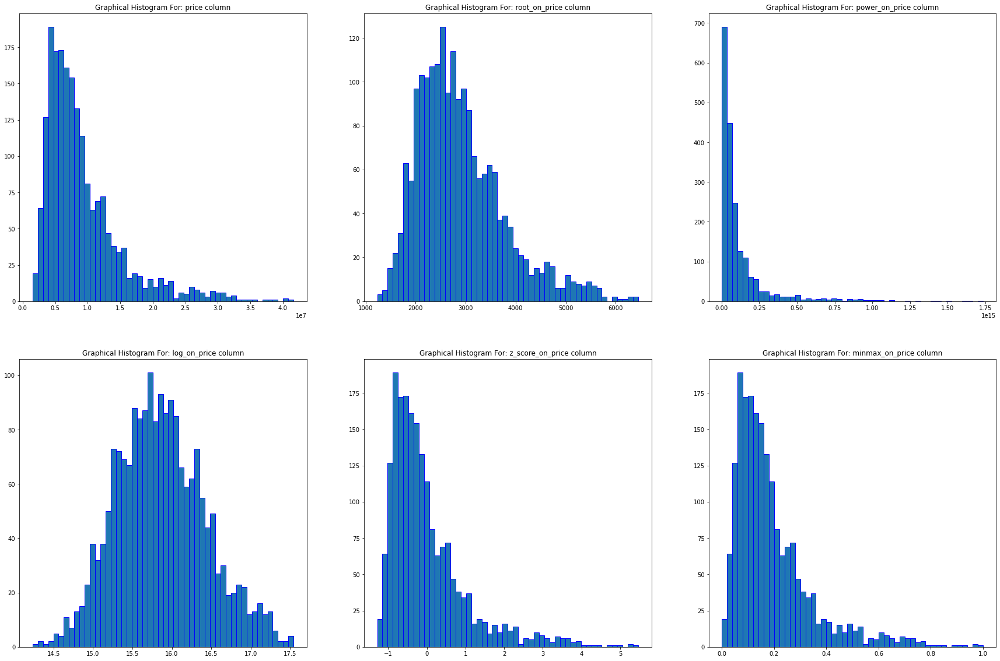

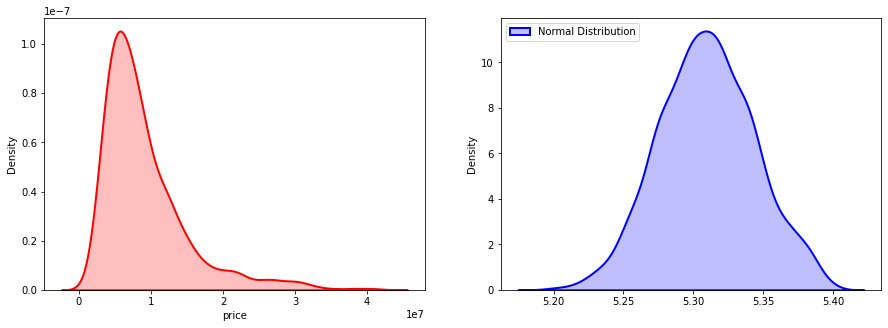

In [58]:
price_figure, price_axis = plt.subplots(nrows=2, ncols=3, figsize=(30, 20)) # Specifying the dimensions of the plot

price_reshape_data_columns = ['price','root_on_price','power_on_price','log_on_price','z_score_on_price','minmax_on_price'] # Will specify the columns for the plots
for each_axis, each_column in zip_longest(price_axis.flat, price_reshape_data_columns): # For each column in the column names
    each_axis.hist(price_reshape_data[each_column], bins=50, edgecolor='blue') # Will plot the histogram
    each_axis.set_title("Graphical Histogram For: " +each_column + " column") # Will set the title for each of the histogram

# This part of the code will be used to perform Boxcox Transformation  
price_box_data, price_lambda_value = stats.boxcox(property_data_integration['price'].astype(float)) # Will transform the property price and will also save the lambda value
price_figure_box, price_axis_box = plt.subplots(1, 2) # Will create axes for the plots
  
# Will plot the original property prices
sns.distplot(property_data_integration['price'].astype(float), hist = False, kde = True, kde_kws = {'shade': True, 'linewidth': 2}, label = "Non-Normal Distribution", color ="red", ax = price_axis_box[0]) 
# Will plot the transformed property prices
sns.distplot(price_box_data, hist = False, kde = True, kde_kws = {'shade': True, 'linewidth': 2}, label = "Normal Distribution", color ="blue", ax = price_axis_box[1])  

plt.legend(loc = "upper left") # Will add legends to the plots 

price_figure_box.set_figheight(5) # Will be used to rescale the plots
price_figure_box.set_figwidth(15) # Will be used to rescale the plots

print("Lambda Value For Property price Transformation: ", price_lambda_value) # Will display the lambda value

### 8.2.2 Data Description
In the following sub-section, a function named `describe()` was used to provide a small description of the `transformed data` (named `price_reshape_data`) which was discovered in the previous section (`section 8.2`). In addition to this, the mean value of the transformed data (by using the data from `StandardScaler()`) was also calculated by using a `mean()` function. The mean values which were calculated before this transformation are available in `section 8.1`. The `standard deviation` of the `price` column was `5.94` (available in the `section 7.21.1`) before any kind of transformation was done, and after the transformation, the standard deviation was found out to be `1.0` (Available in the section below).

In [59]:
print("Mean Before The Transformation: ", price_mean) # Will display the mean before any transformation was done
print("Mean Value After The Transformation: ", price_reshape_data['z_score_on_price'].mean()) # Will calculate the mean value after the transformation
price_reshape_data.describe() # Will describe the transformed dataset

Mean Before The Transformation:  9151504.615384616
Mean Value After The Transformation:  -1.002047447866808e-16


,property_id,price,root_on_price,power_on_price,log_on_price,z_score_on_price,minmax_on_price
count,1950.000000,1.950000e+03,1950.000000,1.950000e+03,1950.000000,1.950000e+03,1950.000000
mean,48534.933846,9.151505e+06,2897.415288,1.190591e+14,15.860234,-1.002047e-16,0.190210
std,27336.098410,5.943669e+06,869.987015,1.858808e+14,0.569012,1.000257e+00,0.148103
min,7.000000,1.518000e+06,1232.071427,2.304324e+12,14.232904,-1.284638e+00,0.000000
25%,25964.250000,5.135500e+06,2266.164152,2.637336e+13,15.451688,-6.758510e-01,0.090140
50%,49225.500000,7.516500e+06,2741.623532,5.649778e+13,15.832611,-2.751539e-01,0.149469
75%,71187.000000,1.130475e+07,3362.253708,1.277974e+14,16.240734,3.623684e-01,0.243864
max,97098.000000,4.165000e+07,6453.681120,1.734722e+15,17.544812,5.469152e+00,1.000000


## 8.3 Basic Normalization/Transformation Techniques On The Distance_to_sc Column
In the following section, basic transformation techniques such as `Root Transformation`, `Power Transformation`, `Log Transformation`, `Z-Score Normalisation`, and `MinMax Normalisation` were applied on the values of the `Distance_to_sc` column of the final dataset (`property_data_integration`). The resulting values were then stored into a dataframe named `shopping_reshape_data` so the `actual distance` can be compared with the `transformed` values.

In [60]:
shopping_reshape_data = pd.DataFrame({'property_id': prop_id_final, 'Distance_to_sc': property_data_integration['Distance_to_sc'].astype(float)}) # Will create a dataframe for the transformation values

shopping_reshape_data['root_on_shopping'] = np.sqrt(shopping_reshape_data.Distance_to_sc) # Will apply root transformation on the Distance_to_sc column

shopping_reshape_data['power_on_shopping'] = np.power(shopping_reshape_data.Distance_to_sc,2) # Will apply power transformation on the Distance_to_sc column

shopping_reshape_data['log_on_shopping'] = np.log(shopping_reshape_data.Distance_to_sc) # Will apply log transformation on the Distance_to_sc column

shop_standard_scale = preprocessing.StandardScaler().fit(shopping_reshape_data[['Distance_to_sc']]) # Will use the StandardScaler() function to fit the Distance_to_sc data to apply Z-Score Normalization
shop_standard_scale_df = shop_standard_scale.transform(shopping_reshape_data[['Distance_to_sc']]) # Will transform the data
shop_standard_scale_df[0:5] # Will slice the require data
shopping_reshape_data['z_score_on_shopping'] = shop_standard_scale_df[:,0] # Will store the required values into a new column

shop_minmax_scale = preprocessing.MinMaxScaler().fit(shopping_reshape_data[['Distance_to_sc']]) # Will use the MinMaxScaler() function to apply MinMax Normalization
shop_minmax_scale_df = shop_minmax_scale.transform(shopping_reshape_data[['Distance_to_sc']]) # Will transform the data
shopping_reshape_data['minmax_on_shopping'] = shop_minmax_scale_df[:,0] # Will store the required values into a new column

shopping_reshape_data # Will display the dataframe

,property_id,Distance_to_sc,root_on_shopping,power_on_shopping,log_on_shopping,z_score_on_shopping,minmax_on_shopping
0,75592,1135.0,33.689761,1288225.0,7.034388,-1.002226,0.183842
1,34842,2977.0,54.561891,8862529.0,7.998671,0.328807,0.494518
2,51236,1887.0,43.439613,3560769.0,7.542744,-0.458829,0.310676
3,30689,2234.0,47.265209,4990756.0,7.711549,-0.208086,0.369202
4,63099,3004.0,54.808758,9024016.0,8.007700,0.348318,0.499072
5,71638,4550.0,67.453688,20702500.0,8.422883,1.465460,0.759825
6,59101,719.0,26.814175,516961.0,6.577861,-1.302828,0.113679
7,38174,1904.0,43.634848,3625216.0,7.551712,-0.446545,0.313544
8,93076,4124.0,64.218377,17007376.0,8.324579,1.157632,0.687974
9,79441,3792.0,61.579217,14379264.0,8.240649,0.917728,0.631978


### 8.3.1 Reviewing The Normalized/Transformed Data
In the following section, the values which were calculated in the previous section (`section 8.3`) by using `Normalization/Tranformation` were plotted with the help of `matplot` package and the `boxcox()` function. A `for loop` was used to plot a `histogram` for each column, a legend in the `upper-left` corner of the plot was specified by using a function named `legend`, and plots were `rescaled` by using a set of functions named `set_figheight` and `set_figwidth` respectively.

C:\Users\Dhrruv\anaconda3\envs\geo_env\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
C:\Users\Dhrruv\anaconda3\envs\geo_env\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


Lambda Value For Shopping Center Distance Transformation:  0.4032054866103556


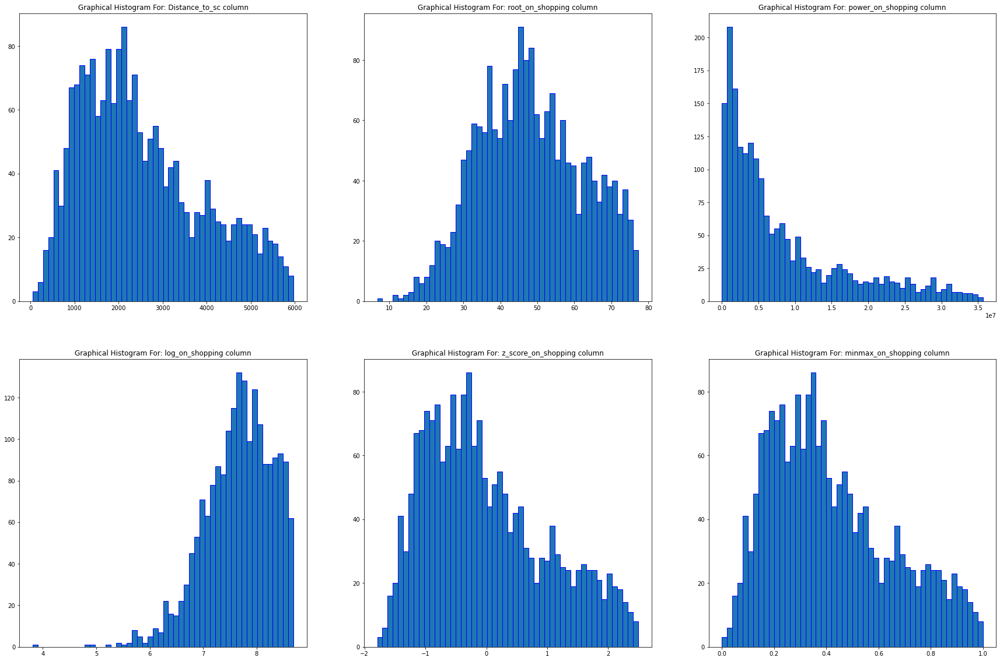

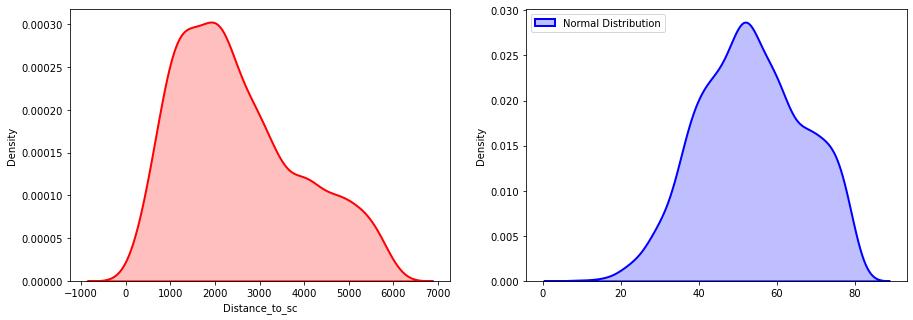

In [61]:
shop_figure, shop_axis = plt.subplots(nrows=2, ncols=3, figsize=(30, 20)) # Specifying the dimensions of the plot

shop_reshape_data_columns = ['Distance_to_sc','root_on_shopping','power_on_shopping','log_on_shopping','z_score_on_shopping','minmax_on_shopping'] # Will specify the columns for the plots
for each_axis_shop, each_column_shop in zip_longest(shop_axis.flat, shop_reshape_data_columns): # For each column in the column names
    each_axis_shop.hist(shopping_reshape_data[each_column_shop], bins=50, edgecolor='blue') # Will plot the histogram
    each_axis_shop.set_title("Graphical Histogram For: " +each_column_shop + " column") # Will set the title for each of the histogram

# This part of the code will be used to perform Boxcox Transformation  
shopping_box_data, shopping_lambda_value = stats.boxcox(property_data_integration['Distance_to_sc'].astype(float)) # Will transform the shopping center distance values and will also save the lambda value
shopping_figure_box, shopping_axis_box = plt.subplots(1, 2) # Will create axes for the plots
  
# Will plot the original shopping center distance values
sns.distplot(property_data_integration['Distance_to_sc'].astype(float), hist = False, kde = True, kde_kws = {'shade': True, 'linewidth': 2}, label = "Non-Normal Distribution", color ="red", ax = shopping_axis_box[0]) 
# Will plot the transformed shopping center distance values
sns.distplot(shopping_box_data, hist = False, kde = True, kde_kws = {'shade': True, 'linewidth': 2}, label = "Normal Distribution", color ="blue", ax = shopping_axis_box[1])  

plt.legend(loc = "upper left") # Will add legends to the plots 

shopping_figure_box.set_figheight(5) # Will be used to rescale the plots
shopping_figure_box.set_figwidth(15) # Will be used to rescale the plots

print("Lambda Value For Shopping Center Distance Transformation: ", shopping_lambda_value) # Will display the lambda value    

### 8.3.2 Data Description
In the following sub-section, a function named `describe()` was used to provide a small description of the `transformed data` (named `shopping_reshape_data`) which was discovered in the previous section (`section 8.3`). In addition to this, the mean value of the transformed data was also calculated by using a `mean()` function. The mean values which were calculated before this transformation are available in `section 8.1`. The `standard deviation` of the `Distance_to_sc` column was `1384.24` (available in the `section 7.21.1`) before any kind of transformation was done, and after the transformation, the standard deviation was found out to be `1.0` (Available in the section below).

In [62]:
print("Mean Before The Transformation: ", shopping_center_mean) # Will display the mean before any transformation was done
print("Mean Value After The Transformation: ", shopping_reshape_data['z_score_on_shopping'].mean()) # Will calculate the mean value after the transformation
shopping_reshape_data.describe() # Will describe the transformed dataset

Mean Before The Transformation:  2521.9676923076922
Mean Value After The Transformation:  5.465713352000771e-17


,property_id,Distance_to_sc,root_on_shopping,power_on_shopping,log_on_shopping,z_score_on_shopping,minmax_on_shopping
count,1950.000000,1950.000000,1950.000000,1.950000e+03,1950.000000,1.950000e+03,1950.000000
mean,48534.933846,2521.967692,48.227842,8.275465e+06,7.658436,5.465713e-17,0.417772
std,27336.098410,1384.242419,14.005124,8.375911e+06,0.634724,1.000257e+00,0.233470
min,7.000000,45.000000,6.708204,2.025000e+03,3.806662,-1.789862e+00,0.000000
25%,25964.250000,1411.250000,37.566607,1.991627e+06,7.252231,-8.026070e-01,0.230435
50%,49225.500000,2234.500000,47.270498,4.992990e+06,7.711773,-2.077248e-01,0.369287
75%,71187.000000,3408.000000,58.378076,1.161447e+07,8.133881,6.402488e-01,0.567212
max,97098.000000,5974.000000,77.291655,3.568868e+07,8.695172,2.494446e+00,1.000000


## 8.4 Basic Normalization/Transformation Techniques On The travel_min_to_CBD Column
In the following section, basic transformation techniques such as `Root Transformation`, `Power Transformation`, `Z-Score Normalisation`, and `MinMax Normalisation` were applied on the values of the `“travel_min_to_CBD”` column of the final dataset (`property_data_integration`). The resulting values were then stored into a dataframe named `cbd_reshape_data` so the `actual distance` can be compared with the `transformed` values.

In [63]:
cbd_reshape_data = pd.DataFrame({'property_id': prop_id_final, 'travel_min_to_CBD': property_data_integration['travel_min_to_CBD'].astype(float)}) # Will create a dataframe for the transformation values

cbd_reshape_data['root_on_cbd'] = np.sqrt(cbd_reshape_data.travel_min_to_CBD) # Will apply root transformation on the travel_min_to_CBD column

cbd_reshape_data['power_on_cbd'] = np.power(cbd_reshape_data.travel_min_to_CBD,2) # Will apply power transformation on the travel_min_to_CBD column

#cbd_reshape_data['log_on_cbd'] = np.log(cbd_reshape_data.travel_min_to_CBD) # Will apply log transformation on the travel_min_to_CBD column

cbd_standard_scale = preprocessing.StandardScaler().fit(cbd_reshape_data[['travel_min_to_CBD']]) # Will use the StandardScaler() function to fit the travel_min_to_CBD data to apply Z-Score Normalization
cbd_standard_scale_df = cbd_standard_scale.transform(cbd_reshape_data[['travel_min_to_CBD']]) # Will transform the data
cbd_standard_scale_df[0:5] # Will slice the require data
cbd_reshape_data['z_score_on_cbd'] = cbd_standard_scale_df[:,0] # Will store the required values into a new column

cbd_minmax_scale = preprocessing.MinMaxScaler().fit(cbd_reshape_data[['travel_min_to_CBD']]) # Will use the MinMaxScaler() function to apply MinMax Normalization
cbd_minmax_scale_df = cbd_minmax_scale.transform(cbd_reshape_data[['travel_min_to_CBD']]) # Will transform the data
cbd_reshape_data['minmax_on_cbd'] = cbd_minmax_scale_df[:,0] # Will store the required values into a new column

cbd_reshape_data # Will display the dataframe

,property_id,travel_min_to_CBD,root_on_cbd,power_on_cbd,z_score_on_cbd,minmax_on_cbd
0,75592,34.0,5.830952,1156.0,0.031817,0.557377
1,34842,32.0,5.656854,1024.0,-0.131028,0.524590
2,51236,26.0,5.099020,676.0,-0.619563,0.426230
3,30689,23.0,4.795832,529.0,-0.863830,0.377049
4,63099,46.0,6.782330,2116.0,1.008888,0.754098
5,71638,46.0,6.782330,2116.0,1.008888,0.754098
6,59101,36.0,6.000000,1296.0,0.194662,0.590164
7,38174,18.0,4.242641,324.0,-1.270943,0.295082
8,93076,44.0,6.633250,1936.0,0.846043,0.721311
9,79441,46.0,6.782330,2116.0,1.008888,0.754098


### 8.4.1 Reviewing The Normalized/Transformed Data
In the following section, the values which were calculated in the previous section (section `8.4`) by using `Normalization/Tranformation` were plotted with the help of `matplot` package and the `boxcox()` function. A `for loop` was used to plot a `histogram` for each column.

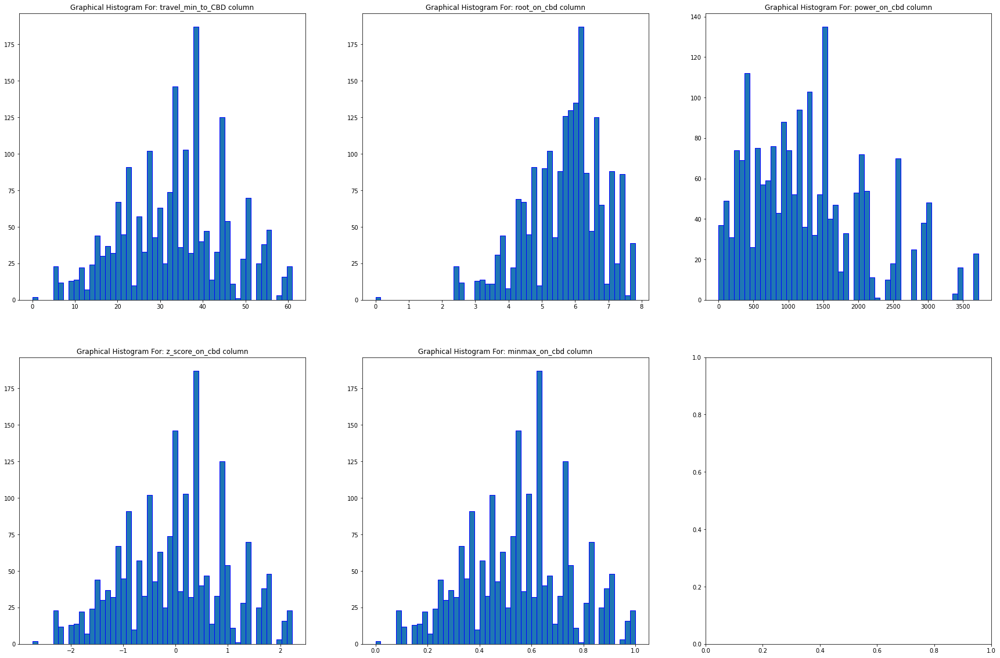

In [64]:
cbd_figure, cbd_axis = plt.subplots(nrows=2, ncols=3, figsize=(30, 20)) # Specifying the dimensions of the plot

cbd_reshape_data_columns = ['travel_min_to_CBD','root_on_cbd','power_on_cbd','z_score_on_cbd','minmax_on_cbd'] # Will specify the columns for the plots

try: # Will check for errors
    for each_axis_cbd, each_column_cbd in zip_longest(cbd_axis.flat, cbd_reshape_data_columns): # For each column in the column names
        each_axis_cbd.hist(cbd_reshape_data[each_column_cbd], bins=50, edgecolor='blue') # Will plot the histogram
        each_axis_cbd.set_title("Graphical Histogram For: " +each_column_cbd + " column") # Will set the title for each of the histogram
except: # If there's any exception, then pass
    pass

### 8.4.2 Data Description
In the following sub-section, a function named `describe()` was used to provide a small description of the `transformed data` (named `cbd_reshape_data`) which was discovered in the previous section (`section 8.4`). In addition to this, the mean value of the transformed data was also calculated by using a `mean()` function. The mean values which were calculated before this transformation are available in `section 8.1`. The `standard deviation` of the `travel_min_to_CBD` column was `12.28` (available in the `section 7.21.1`) before any kind of transformation was done, and after the transformation, the standard deviation was found out to be `1.0` (Available in the section below).

In [65]:
print("Mean Before The Transformation: ", cbd_mean) # Will display the mean before any transformation was done
print("Mean Value After The Transformation: ", cbd_reshape_data['z_score_on_cbd'].mean()) # Will calculate the mean value after the transformation
cbd_reshape_data.describe() # Will describe the transformed dataset

Mean Before The Transformation:  33.60923076923077
Mean Value After The Transformation:  -6.080606104100857e-17


,property_id,travel_min_to_CBD,root_on_cbd,power_on_cbd,z_score_on_cbd,minmax_on_cbd
count,1950.000000,1950.000000,1950.000000,1950.000000,1.950000e+03,1950.000000
mean,48534.933846,33.609231,5.684150,1280.418462,-6.080606e-17,0.550971
std,27336.098410,12.284765,1.140324,840.063248,1.000257e+00,0.201390
min,7.000000,0.000000,0.000000,0.000000,-2.736548e+00,0.000000
25%,25964.250000,25.000000,5.000000,625.000000,-7.009852e-01,0.409836
50%,49225.500000,34.000000,5.830952,1156.000000,3.181741e-02,0.557377
75%,71187.000000,42.000000,6.480741,1764.000000,6.831975e-01,0.688525
max,97098.000000,61.000000,7.810250,3721.000000,2.230225e+00,1.000000


## 8.5 Basic Normalization/Transformation Techniques On The Distance_to_hospital Column
In the following section, basic transformation techniques such as `Root Transformation`, `Power Transformation`, `Log Transformation`, `Z-Score Normalisation`, and `MinMax Normalisation` were applied on the values of the `“Distance_to_hospital”` column of the final dataset (`property_data_integration`). The resulting values were then stored into a dataframe named `hospital_reshape_data` so the `actual distance` can be compared with the `transformed` values.

In [66]:
hospital_reshape_data = pd.DataFrame({'property_id': prop_id_final, 'Distance_to_hospital': property_data_integration['Distance_to_hospital'].astype(float)}) # Will create a dataframe for the transformation values

hospital_reshape_data['root_on_hospital'] = np.sqrt(hospital_reshape_data.Distance_to_hospital) # Will apply root transformation on the Distance_to_hospital column

hospital_reshape_data['power_on_hospital'] = np.power(hospital_reshape_data.Distance_to_hospital,2) # Will apply power transformation on the Distance_to_hospital column

hospital_reshape_data['log_on_hospital'] = np.log(hospital_reshape_data.Distance_to_hospital) # Will apply log transformation on the Distance_to_hospital column

hospital_standard_scale = preprocessing.StandardScaler().fit(hospital_reshape_data[['Distance_to_hospital']]) # Will use the StandardScaler() function to fit the Distance_to_hospital data to apply Z-Score Normalization
hospital_standard_scale_df = hospital_standard_scale.transform(hospital_reshape_data[['Distance_to_hospital']]) # Will transform the data
hospital_standard_scale_df[0:5] # Will slice the require data
hospital_reshape_data['z_score_on_hospital'] = hospital_standard_scale_df[:,0] # Will store the required values into a new column

hospital_minmax_scale = preprocessing.MinMaxScaler().fit(hospital_reshape_data[['Distance_to_hospital']]) # Will use the MinMaxScaler() function to apply MinMax Normalization
hospital_minmax_scale_df = hospital_minmax_scale.transform(hospital_reshape_data[['Distance_to_hospital']]) # Will transform the data
hospital_reshape_data['minmax_on_hospital'] = hospital_minmax_scale_df[:,0] # Will store the required values into a new column

hospital_reshape_data # Will display the dataframe

,property_id,Distance_to_hospital,root_on_hospital,power_on_hospital,log_on_hospital,z_score_on_hospital,minmax_on_hospital
0,75592,1895.0,43.531598,3591025.0,7.546974,-0.177316,0.200217
1,34842,782.0,27.964263,611524.0,6.661855,-0.811723,0.079632
2,51236,484.0,22.000000,234256.0,6.182085,-0.981583,0.047346
3,30689,869.0,29.478806,755161.0,6.767343,-0.762133,0.089057
4,63099,2165.0,46.529560,4687225.0,7.680176,-0.023416,0.229469
5,71638,542.0,23.280893,293764.0,6.295266,-0.948523,0.053629
6,59101,1728.0,41.569219,2985984.0,7.454720,-0.272505,0.182124
7,38174,1526.0,39.064050,2328676.0,7.330405,-0.387645,0.160238
8,93076,3108.0,55.749439,9659664.0,8.041735,0.514092,0.331636
9,79441,2186.0,46.754679,4778596.0,7.689829,-0.011446,0.231744


### 8.5.1 Reviewing The Normalized/Transformed Data
In the following section, the values which were calculated in the previous section (section `8.5`) by using `Normalization/Tranformation` were plotted with the help of `matplot` package and the `boxcox()` function. A `for loop` was used to plot a `histogram` for each column, a legend in the `upper-left` corner of the plot was specified by using a function named `legend`, and plots were `rescaled` by using a set of functions named `set_figheight` and `set_figwidth` respectively.

C:\Users\Dhrruv\anaconda3\envs\geo_env\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
C:\Users\Dhrruv\anaconda3\envs\geo_env\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


Lambda Value For Shopping Center Distance Transformation:  0.1944240449999896


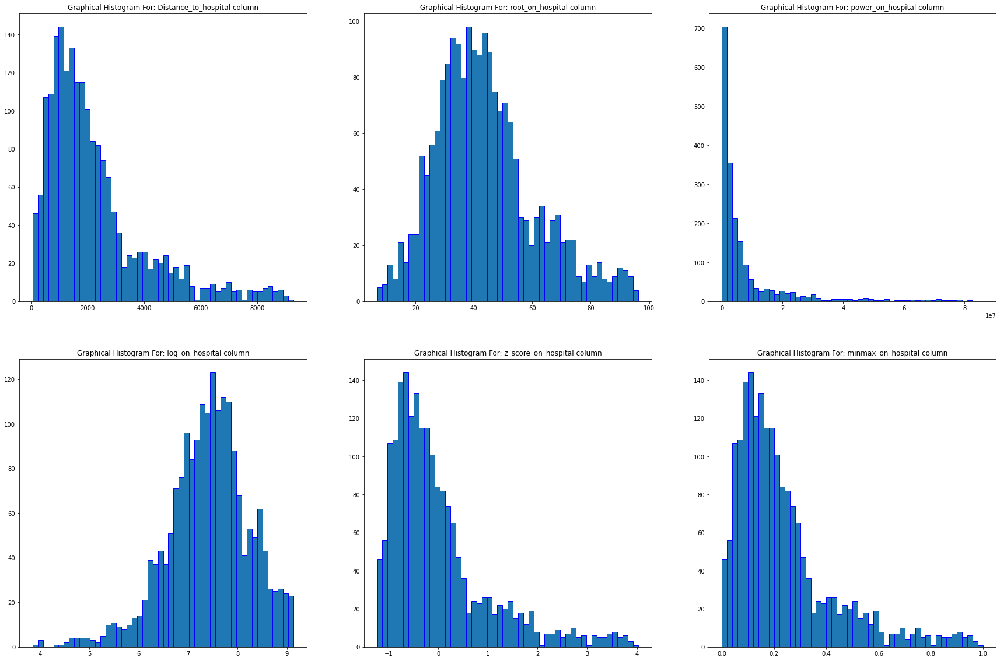

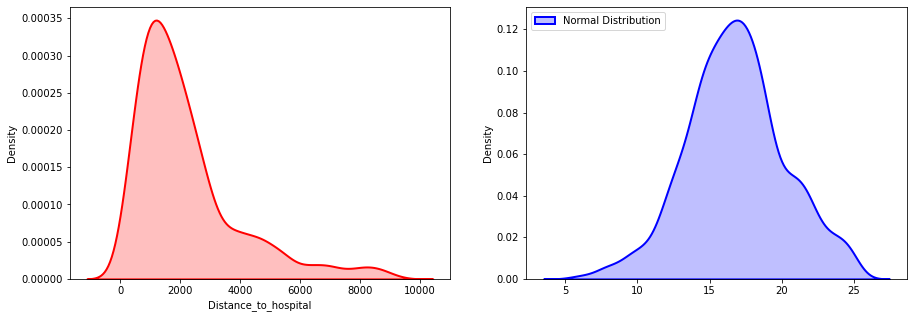

In [67]:
hospital_figure, hospital_axis = plt.subplots(nrows=2, ncols=3, figsize=(30, 20)) # Specifying the dimensions of the plot

hospital_reshape_data_columns = ['Distance_to_hospital','root_on_hospital','power_on_hospital','log_on_hospital','z_score_on_hospital','minmax_on_hospital'] # Will specify the columns for the plots
for each_axis_hospital, each_column_hospital in zip_longest(hospital_axis.flat, hospital_reshape_data_columns): # For each column in the column names
    each_axis_hospital.hist(hospital_reshape_data[each_column_hospital], bins=50, edgecolor='blue') # Will plot the histogram
    each_axis_hospital.set_title("Graphical Histogram For: " +each_column_hospital + " column") # Will set the title for each of the histogram

# This part of the code will be used to perform Boxcox Transformation  
hospital_box_data, hospital_lambda_value = stats.boxcox(property_data_integration['Distance_to_hospital'].astype(float)) # Will transform the hospital distance values and will also save the lambda value
hospital_figure_box, hospital_axis_box = plt.subplots(1, 2) # Will create axes for the plots
  
# Will plot the original hospital distance values
sns.distplot(property_data_integration['Distance_to_hospital'].astype(float), hist = False, kde = True, kde_kws = {'shade': True, 'linewidth': 2}, label = "Non-Normal Distribution", color ="red", ax = hospital_axis_box[0]) 
# Will plot the transformed hospital distance values
sns.distplot(hospital_box_data, hist = False, kde = True, kde_kws = {'shade': True, 'linewidth': 2}, label = "Normal Distribution", color ="blue", ax = hospital_axis_box[1])  

plt.legend(loc = "upper left") # Will add legends to the plots 

hospital_figure_box.set_figheight(5) # Will be used to rescale the plots
hospital_figure_box.set_figwidth(15) # Will be used to rescale the plots

print("Lambda Value For Shopping Center Distance Transformation: ", hospital_lambda_value) # Will display the lambda value    

### 8.5.2 Data Description
In the following sub-section, a function named `describe()` was used to provide a small description of the `transformed data` (named `hospital_reshape_data`) which was discovered in the previous section (`section 8.5`). In addition to this, the mean value of the transformed data was also calculated by using a `mean()` function. The mean values which were calculated before this transformation are available in `section 8.1`. The `standard deviation` of the `Distance_to_hospital` column was `1754.84` (available in the `section 7.21.1`) before any kind of transformation was done, and after the transformation, the standard deviation was found out to be `1.0` (Available in the section below).

In [68]:
print("Mean Before The Transformation: ", hospital_mean) # Will display the mean before any transformation was done
print("Mean Value After The Transformation: ", hospital_reshape_data['z_score_on_hospital'].mean()) # Will calculate the mean value after the transformation
hospital_reshape_data.describe() # Will describe the transformed dataset

Mean Before The Transformation:  2206.0810256410255
Mean Value After The Transformation:  8.745141363201233e-17


,property_id,Distance_to_hospital,root_on_hospital,power_on_hospital,log_on_hospital,z_score_on_hospital,minmax_on_hospital
count,1950.000000,1950.000000,1950.000000,1.950000e+03,1950.000000,1.950000e+03,1950.000000
mean,48534.933846,2206.081026,43.729982,7.944686e+06,7.395732,8.745141e-17,0.233920
std,27336.098410,1754.842365,17.144109,1.349952e+07,0.828743,1.000257e+00,0.190124
min,7.000000,47.000000,6.855655,2.209000e+03,3.850148,-1.230672e+00,0.000000
25%,25964.250000,1011.500000,31.804085,1.023133e+06,6.919189,-6.809087e-01,0.104496
50%,49225.500000,1719.000000,41.460825,2.954961e+06,7.449498,-2.776352e-01,0.181148
75%,71187.000000,2732.750000,52.275711,7.467923e+06,7.913064,3.002002e-01,0.290980
max,97098.000000,9277.000000,96.317184,8.606273e+07,9.135293,4.030409e+00,1.000000


## 8.6 Predicting Property Price Using A Linear Model
In the following section, a `Linear Model` was created with the help of `sklearn` package to predict the price of each of the property.

### 8.6.1 Fitting The Dependent And Independent Attributes Into A Linear Model
In the following sub-section, the independent variables were `fitted` into a `linear regression model` with the help of `reg` (`LinearRegression()`) function and the `intercept` (`reg.intercept_`) and the `coefficient` (`reg.coef_`) were displayed.

In [69]:
reg = LinearRegression() # Will be used to create a linear model
reg.fit(property_data_integration[['Distance_to_sc','travel_min_to_CBD','Distance_to_hospital']],property_data_integration['price']) # Will fit the dependent and independent variables into the model
print("Intercept: ", reg.intercept_) # Will display the intercept
print("Coefficient: ", reg.coef_) # Will display the coeffcients

Intercept:  15163722.720742969
Coefficient:  [   -214.91995099 -120261.00631988    -647.44540295]


### 8.6.2 Predicting The Price Of Each Property
In the following section, the `LinearRegression` function which was created in the previous section (`section 8.6.1`) was used in this section to `predict` (by using a `predict()` function) the `price` of each `property` using a `Linear Model` (named `reg`, was created in the `section 8.5.1`). The model takes following `independent variables` as input:
* Distance to the nearest shopping center (`Distance_to_sc`).
* Minimum average time taken to travel to the CBD (`travel_min_to_CBD`).
* Distance to the nearest hospital (`Distance_to_hospital`).

The main aim of this `Linear Model` is to `predict` the `price` (`dependent variable`) of each property.

In [70]:
predict_property_price = [] # Will create an empty dictionary which will be used store all the predicted values 

for nearest_shopping_center, min_travel_time_cbd, nearest_hospital, property_price_value in zip_longest(property_data_integration['Distance_to_sc'],property_data_integration['travel_min_to_CBD'],property_data_integration['Distance_to_hospital'],property_data_integration['price']): # For all the dependent variables in the Distance_to_sc, travel_min_to_CBD, Distance_to_hospital, and independent variable named price
    predicted_price = reg.predict([[nearest_shopping_center,min_travel_time_cbd,nearest_hospital]]) # Will predict the value 
    predict_property_price.append(predicted_price.item()) # Will extract the item from the array and that item (predicted value) will be appended into the predict_property_price list

# Will create a dataframe to show the difference between the original price and the predicted price
predicted_property_price_data = pd.DataFrame({'property_id': prop_id_final, 'Distance_to_sc': property_data_integration['Distance_to_sc'], 'travel_min_to_CBD': property_data_integration['travel_min_to_CBD'], 'Distance_to_hospital': property_data_integration['Distance_to_hospital'], 'price': property_data_integration['price'], 'predicted_price': predict_property_price})
predicted_property_price_data['predicted_price'] = predicted_property_price_data['predicted_price'].astype(int) # Will convert the price of each property into an integer

predicted_property_price_data # Will display the dataframe

,property_id,Distance_to_sc,travel_min_to_CBD,Distance_to_hospital,price,predicted_price
0,75592,1135,34,1895,6345000,9604005
1,34842,2977,32,782,6240000,10169251
2,51236,1887,26,484,13500000,11318019
3,30689,2234,23,869,6040000,11354958
4,63099,3004,46,2165,6640000,7584377
5,71638,4550,46,542,3864000,8302915
6,59101,719,36,1728,10758000,9561013
7,38174,1904,18,1526,12740000,11601815
8,93076,4124,44,3108,5616000,6973648
9,79441,3792,46,2186,6150000,7401424


#### 8.6.2.1 Creating A Linear Model For The Z-Score Normalization Values
In the following sub-section, this time, `Z-Score Normalization` values of independent variables (`z_score_on_shopping`, `z_score_on_cbd`, `z_score_on_hospital`) and the independent variable (`z_score_on_price`) were `fitted` (by using a `fit()` function) into a `Linear Model` (named `reg_z_score`) to `predict` the `property price`. The `predicted` values were first appended into a list named `predict_property_price_z_score`n and then this list was later converted into a column of a dataframe named `predicted_property_price_data_z_score`. At the end of this section, the `predicted property price` values were displayed.

In [71]:
# Will create a dataframe to combine to combine all z-score values into one 
z_score_price_shop_cbd_hosp = pd.DataFrame({'property_id': prop_id_final, 'z_score_on_shopping': shopping_reshape_data['z_score_on_shopping'], 'z_score_on_cbd': cbd_reshape_data['z_score_on_cbd'], 'z_score_on_hospital': hospital_reshape_data['z_score_on_hospital'], 'z_score_on_price': price_reshape_data['z_score_on_price']})

reg_z_score = LinearRegression() # Will be used to create a linear model
reg_z_score.fit(z_score_price_shop_cbd_hosp[['z_score_on_shopping','z_score_on_cbd','z_score_on_hospital']],z_score_price_shop_cbd_hosp['z_score_on_price']) # Will fit the dependent and independent variables into the model

print(reg_z_score.intercept_) # Will display the intercept
print(reg_z_score.coef_) # Will display the coeffcients

predict_property_price_z_score = [] # Will create an empty dictionary which will be used store all the predicted values 

for nearest_shopping_center_z, min_travel_time_cbd_z, nearest_hospital_z, property_price_value_z in zip_longest(z_score_price_shop_cbd_hosp['z_score_on_shopping'],z_score_price_shop_cbd_hosp['z_score_on_cbd'],z_score_price_shop_cbd_hosp['z_score_on_hospital'],z_score_price_shop_cbd_hosp['z_score_on_price']): # For all the dependent variables in the z_score_on_shopping, z_score_on_cbd, z_score_on_hospital, and independent variable named z_score_on_price
    predicted_price_z_score = reg_z_score.predict([[nearest_shopping_center_z, min_travel_time_cbd_z, nearest_hospital_z]]) # Will predict the value 
    predict_property_price_z_score.append(predicted_price_z_score.item()) # Will extract the item from the array and that item (predicted value) will be appended into the predict_property_price list

# Will create a dataframe to show the difference between the original price and the predicted price
predicted_property_price_data_z_score = pd.DataFrame({'property_id': prop_id_final, 'z_score_on_shopping': shopping_reshape_data['z_score_on_shopping'], 'z_score_on_cbd': cbd_reshape_data['z_score_on_cbd'], 'z_score_on_hospital': hospital_reshape_data['z_score_on_hospital'], 'z_score_on_price': price_reshape_data['z_score_on_price'], 'predicted_price_z_score': predict_property_price_z_score})

predicted_property_price_data_z_score # Will display the dataframe

-9.586631041365818e-17
[-0.05005348 -0.24856333 -0.19115542]


,property_id,z_score_on_shopping,z_score_on_cbd,z_score_on_hospital,z_score_on_price,predicted_price_z_score
0,75592,-1.002226,0.031817,-0.177316,-0.472305,0.076151
1,34842,0.328807,-0.131028,-0.811723,-0.489975,0.171276
2,51236,-0.458829,-0.619563,-0.981583,0.731806,0.364601
3,30689,-0.208086,-0.863830,-0.762133,-0.523633,0.370818
4,63099,0.348318,1.008888,-0.023416,-0.422660,-0.263731
5,71638,1.465460,1.008888,-0.948523,-0.889831,-0.142809
6,59101,-1.302828,0.194662,-0.272505,0.270356,0.068916
7,38174,-0.446545,-1.270943,-0.387645,0.603906,0.412361
8,93076,1.157632,0.846043,0.514092,-0.594988,-0.366510
9,79441,0.917728,1.008888,-0.011446,-0.505121,-0.294520


## 8.7 Applying Z-Score Normalization
In the following section, unlike previous sections, `Z-Score Normalization` was applied (by using a `StandardScaler()` function) to columns named `price`, `Distance_to_sc`, `travel_min_to_CBD`, and 'Distance_to_hospital' respectively. The data was then transformed by using a `transform()` fucntion, and the `Z-Score` values of these columns were then `fitted` into a `Linear Model` which was created in the `section 8.7.1`.

,property_id,price_z_score,Distance_to_sc_z_score,travel_min_to_CBD_z_score,Distance_to_hospital_z_score
0,75592,-0.472305,-1.002226,0.031817,-0.177316
1,34842,-0.489975,0.328807,-0.131028,-0.811723
2,51236,0.731806,-0.458829,-0.619563,-0.981583
3,30689,-0.523633,-0.208086,-0.863830,-0.762133
4,63099,-0.422660,0.348318,1.008888,-0.023416
5,71638,-0.889831,1.465460,1.008888,-0.948523
6,59101,0.270356,-1.302828,0.194662,-0.272505
7,38174,0.603906,-0.446545,-1.270943,-0.387645
8,93076,-0.594988,1.157632,0.846043,0.514092
9,79441,-0.505121,0.917728,1.008888,-0.011446


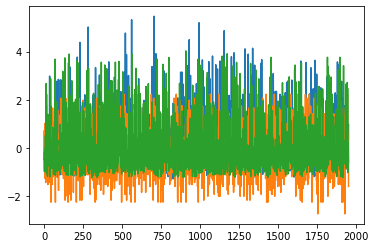

In [72]:
z_score_normalization = preprocessing.StandardScaler().fit(property_data_integration[['price', 'Distance_to_sc','travel_min_to_CBD','Distance_to_hospital']]) # Will call the StandardScaler() function to fit the data
z_score_normalization_df = z_score_normalization.transform(property_data_integration[['price', 'Distance_to_sc','travel_min_to_CBD','Distance_to_hospital']]) # Will transform the data
z_score_normalization_df[0:5] # Will slice the data
z_score_reshape_data = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for the z-score values

z_score_reshape_data['price_z_score'] = z_score_normalization_df[:,0] # Will extract the transformed data into a new column
z_score_reshape_data['Distance_to_sc_z_score'] = z_score_normalization_df[:,1] # Will extract the transformed data into a new column
z_score_reshape_data['travel_min_to_CBD_z_score'] = z_score_normalization_df[:,2] # Will extract the transformed data into a new column
z_score_reshape_data['Distance_to_hospital_z_score'] = z_score_normalization_df[:,3] # Will extract the transformed data into a new column

# Will be used to plot the results of the Z-Score Normalization
z_score_reshape_data['price_z_score'].plot(), z_score_reshape_data['Distance_to_sc_z_score'], z_score_reshape_data['travel_min_to_CBD_z_score'].plot(), z_score_reshape_data['Distance_to_hospital_z_score'].plot()
z_score_reshape_data # Will display the transformed data

### 8.7.1 Creating A Linear Model To Fit The Transformed Data (Z-Score Normalization)
In the following sub-section, the data which was transformed in the previous section (`section 8.7`) was then `trained` by using the `train_test_split()` function, and was `fitted` into a `Linear Model` by using a `fit()` function.

In [73]:
linear_model_z_score = LinearRegression() # Will be used to create a linear model
# Will be used to train the data
X_train, x_test, Y_train, y_test = train_test_split(z_score_reshape_data[['Distance_to_sc_z_score','travel_min_to_CBD_z_score','Distance_to_hospital_z_score']], z_score_reshape_data['price_z_score'],random_state=111)
linear_model_z_score.fit(X_train,Y_train)  # Will fir the trained data into the Linear Model

print("R-Squared Value",linear_model_z_score.score(x_test,y_test)) # Will display the score
print("Intercept: ", linear_model_z_score.intercept_) # Will display the intercept
print('Coefficients: ', linear_model_z_score.coef_) # Will display the coefficients

R-Squared Value 0.11425288680971757
Intercept:  -0.0022115183228522016
Coefficients:  [-0.03400864 -0.25559371 -0.18781603]


## 8.8 Applying MinMax Normalization
In the following section, unlike previous sections, `MinMax` was applied (by using a `MinMaxScaler()` function) to columns named `price`, `Distance_to_sc`, `travel_min_to_CBD`, and 'Distance_to_hospital' respectively. The data was then transformed by using a `transform()` fucntion, and the `MinMax` values of these columns were then `fitted` into a `Linear Model` which was created in the `section 8.8.1`.

,property_id,price_minmax,Distance_to_sc_minmax,travel_min_to_CBD_minmax,Distance_to_hospital_minmax
0,75592,0.120278,0.183842,0.557377,0.200217
1,34842,0.117662,0.494518,0.524590,0.079632
2,51236,0.298565,0.310676,0.426230,0.047346
3,30689,0.112678,0.369202,0.377049,0.089057
4,63099,0.127629,0.499072,0.754098,0.229469
5,71638,0.058457,0.759825,0.754098,0.053629
6,59101,0.230240,0.113679,0.590164,0.182124
7,38174,0.279627,0.313544,0.295082,0.160238
8,93076,0.102113,0.687974,0.721311,0.331636
9,79441,0.115419,0.631978,0.754098,0.231744


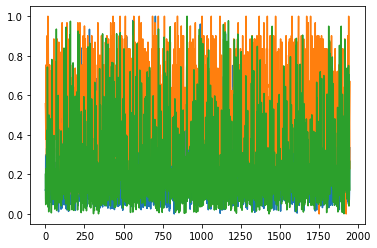

In [74]:
minmax_normalization = preprocessing.MinMaxScaler().fit(property_data_integration[['price', 'Distance_to_sc','travel_min_to_CBD','Distance_to_hospital']]) # Will call the StandardScaler() function to fit the data
minmax_normalization_df = minmax_normalization.transform(property_data_integration[['price', 'Distance_to_sc','travel_min_to_CBD','Distance_to_hospital']]) # Will transform the data
minmax_normalization_df[0:5] # Will slice the data
minmax_reshape_data = pd.DataFrame({'property_id': prop_id_final}) # Will create a dataframe for the MinMax values

minmax_reshape_data['price_minmax'] = minmax_normalization_df[:,0] # Will extract the transformed data into a new column
minmax_reshape_data['Distance_to_sc_minmax'] = minmax_normalization_df[:,1] # Will extract the transformed data into a new column
minmax_reshape_data['travel_min_to_CBD_minmax'] = minmax_normalization_df[:,2] # Will extract the transformed data into a new column
minmax_reshape_data['Distance_to_hospital_minmax'] = minmax_normalization_df[:,3] # Will extract the transformed data into a new column

# Will be used to plot the results of the MinMax Normalization
minmax_reshape_data['price_minmax'].plot(), minmax_reshape_data['Distance_to_sc_minmax'], minmax_reshape_data['travel_min_to_CBD_minmax'].plot(), minmax_reshape_data['Distance_to_hospital_minmax'].plot()
minmax_reshape_data # Will display the transformed data

### 8.8.1 Creating A Linear Model To Fit The Transformed Data (MinMax Normalization)
In the following sub-section, the data which was transformed in the previous section (`section 8.8`) was then trained by using the `train_test_split()` function, and was `fitted` into a `Linear Model` by using a `fit()` function.

In [75]:
linear_model_minmax = LinearRegression() # Will be used to create a linear model
# Will be used to train the data
X_train, x_test, Y_train, y_test = train_test_split(minmax_reshape_data[['Distance_to_sc_minmax','travel_min_to_CBD_minmax','Distance_to_hospital_minmax']], minmax_reshape_data['price_minmax'],random_state=111)
linear_model_minmax.fit(X_train,Y_train)  # Will fir the trained data into the Linear Model

print("R-Squared Value",linear_model_minmax.score(x_test,y_test)) # Will display the score
print("Intercept: ", linear_model_minmax.intercept_) # Will display the intercept
print('Coefficients: ', linear_model_minmax.coef_) # Will display the coefficients

R-Squared Value 0.11425288680971746
Intercept:  0.3366822904688767
Coefficients:  [-0.02157359 -0.18796499 -0.14630531]


# 9. Conclusion
I was given a total of `3` dataset files (`.zip files`), each of which contained several other sub-datasets. The first dataset named `dhrruvtokas.zip` contained `hospitals.xlsx`, `real_state.json`, `real_state.xlsx` ,`shoppingcenter.pdf`, and `supermarkets.html` respectively. These files were extracted from the `.zip` structure in the `section 3.1` and their data was later extracted in the `section 4.1`. The second dataset named `GTFS_Melbourne_Train_Information.zip` contained a total of `8 text files`, these files were `agency.txt`, `calendar.txt`, `calendar_dates.txt`, `routes.txt`, `shapes.txt`, `stop_times.txt`, `stops.txt`, and `trips.txt` respectively. These files were examined and extracted in the `section 5`. The last dataset named `vic_suburb_boundary.zip` contained a total of `4 shape files` which included `VIC_LOCALITY_POLYGON_shp.dbf`, `VIC_LOCALITY_POLYGON_shp.prj`, `VIC_LOCALITY_POLYGON_shp.shp`, and `VIC_LOCALITY_POLYGON_shp.shx` respectively. These files were later reviewed and were used in the later sections to estimate certain `distance values`. In the `section 7`, the required data was calaculated and extracted for each of the output columns. For each column, its extracted data set was then loaded into a dataframe, and all togethere these sums up to be `21 dataframes`. These dataframes were later `combined` into a `single dataframe` which was then converted into a single `CSV` formatted file (`dhrruvtokas_solution.csv`), and this was achieved in the `section 7.21`. After The data was `reshaped` (in `section 8`) by using a set of `Normalization/Transformation` techniques used in the same section, the `property price` of each property was successfully `predicted` and displayed using a `Linear Model`

# 10. References
1. Maurizio Lenzerini. (2002). `Data Integration: A Theoretical Perspective`. A paper published at Proceedings of the Twenty-first ACM SIGACT-SIGMOD-SIGART Symposium on Principles of Database Systems Conference. Retrieved from https://www.researchgate.net/publication/220266329_Data_Integration_A_Theoretical_Perspective

2. Patrick Ziegler & Klaus R. Dittrich. (2007). `Data Integration — Problems, Approaches, and Perspectives`. A paper published in Conceptual Modelling in Information Systems Engineering Book. Retrieved from https://link.springer.com/chapter/10.1007/978-3-540-72677-7_3

3. Yigal Arens, Chin Y. Chee, Chun-Nan Hsu, &Craig A. Knoblock. (1993). `Retrieving and Integrating Data from Multiple Information Sources`. An article published in International Journal of Cooperative Information System. Retrieved from https://www.researchgate.net/publication/220095189_Retrieving_and_Integrating_Data_from_Multiple_Information_Sources

4. Yulia Kostyuchenko. (2018). `Analysis of approaches to data modeling using Python libraries`. A paper published at ITMO University Scientific and Educational Conference. Retrieved from https://www.researchgate.net/publication/335600632_Analysis_of_approaches_to_data_modeling_using_Python_libraries

5. Sankranti Srinivasa Rao. (2020). `Stock Prediction Analysis by using Linear Regression Machine Learning Algorithm`. An article published in International Journal of Innovative Technology and Exploring Engineering (IJITEE). Retrieved from https://www.ijitee.org/wp-content/uploads/papers/v9i4/D1110029420.pdf